<a href="https://colab.research.google.com/github/elinaoik/learning-and-crafting-features-on-face-images/blob/main/learning_and_crafting_features_on_face_images.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Section A: building a dataset

We prepared a small dataset containing pictures of four celebrities. Let's download it, and extract the files.

In [ ]:
import os
import cv2
import tarfile
import numpy as np
from urllib import request
import sys
from google.colab import drive
from google.colab.patches import cv2_imshow
from sklearn.decomposition import PCA
from numpy.linalg import eig
from matplotlib import pyplot as plt
from mpl_toolkits import mplot3d
from matplotlib.offsetbox import OffsetImage, AnnotationBbox
from matplotlib.transforms import Bbox, TransformedBbox
from matplotlib.image import BboxImage
from sklearn import svm
from sklearn.cluster import KMeans
from sklearn.metrics import accuracy_score
from sklearn.neighbors import KNeighborsClassifier
from sklearn.neighbors import NearestNeighbors
from sklearn.neighbors import KDTree
base_path = "/content/sample_data/CV__Group_assignment"

if not os.path.isdir(base_path):
  os.makedirs(base_path)

#vgg_face_dataset_url = "https://dl.dropboxusercontent.com/s/du8fjm4gf5stnlo/Dataset.tar.gz"
vgg_face_dataset_url = "https://dl.dropboxusercontent.com/s/du8fjm4gf5stnlo/Dataset.tar.gz"

with request.urlopen(vgg_face_dataset_url) as r, open(os.path.join(base_path, "vgg_face_dataset.tar.gz"), 'wb') as f:
  f.write(r.read())

with tarfile.open(os.path.join(base_path, "vgg_face_dataset.tar.gz")) as f:
  f.extractall(os.path.join(base_path))

Now let's download a pretrained classifier that we will use to detect faces. This is part of the OpenCV library.



In [ ]:
trained_haarcascade_url = "https://raw.githubusercontent.com/opencv/opencv/master/data/haarcascades/haarcascade_frontalface_default.xml"

with request.urlopen(trained_haarcascade_url) as r, open(os.path.join(base_path, "haarcascade_frontalface_default.xml"), 'wb') as f:
    f.write(r.read())

Now we're ready to extract the pictures of all celebrities. We will use Katy Perry and Tom Hiddleston to train on, and use Zoeey Deschanel and Hugh Laurie (who look similar to our training celebrities) to test the accuracy of our algorithms.

We use 20 training images per celebrity, and 10 test images.

In [ ]:
#all_subjects = [subject for subject in sorted(os.listdir(os.path.join(base_path, "vgg_face_dataset", "files"))) if subject.startswith("B") and subject.endswith(".txt")]
personA = 'Katy_Perry'
personB = 'Tom_Hiddleston'
personC = 'Zooey_Deschanel'
personD = 'Hugh_Laurie'

all_subjects = [personA,personB,personC,personD]


train = []
test = []

subject_list = ["A","B","C","D"]
for subject in subject_list:
  train_subject = []
  test_subject = []
  for file in sorted(os.listdir(os.path.join(base_path,subject,"test"))):
    img = cv2.imread(os.path.join(base_path,subject,"test",file))
    h,w = img.shape[:2]
    #cv2_imshow(cv2.resize(img,(w//3,h//3)))
    test_subject.append(img)
  
  if subject in ["A","B"]:
    for file in os.listdir(os.path.join(base_path,subject,"train")):
      img = cv2.imread(os.path.join(base_path,subject,"train",file))
      h,w = img.shape[:2]
      #cv2_imshow(cv2.resize(img,(w//3,h//3)))
      train_subject.append(img)
    train.append(train_subject)
  test.append(test_subject)

assert len(train) == 2
assert len(train[0]) == 20
assert len(train[0]) == 20
assert len(train[0]) == 20
assert len(test) == 4
assert len(test[0]) == 10


Now we define a few auxiliary functions to resize and display images.

In [ ]:
def resize_to_height(img,height):
  h,w = img.shape[:2]
  return cv2.resize(img,(int(w/h*height),height))

def resize_to_width(img,width):
  h,w = img.shape[:2]
  return cv2.resize(img,(width,int(h/w*width)))


def cv2_imshowmany(images,ncols=5,width=200,channels=3):
  n = len(images)
  nrows = 1 + n//ncols
  images_ = [resize_to_width(img,width) for img in images]
  max_height = 1
  for img in images_:
    if img.shape[0] > max_height:
      max_height = img.shape[0]
  if channels > 1:
    res = np.ones((max_height*nrows,ncols*width,channels))*255
  else:
    res = np.ones((max_height*nrows,ncols*width))*255
  for i in range(len(images_)):
    row = i // ncols
    col = i % ncols
    res[row*max_height:row*max_height+images_[i].shape[0],col*width:(col+1)*width] = images_[i]
  res_ = np.delete(res,np.where(~res.any(axis=1))[0], axis=0)
  cv2_imshow(res_)

All results will be captured in the dictionaries below. Its contents are shown in Section F: Discussion.

In [ ]:
discussion_results = {}
discussion_shapes = {}

## Overview of faces

###Person A: Katy Perry
Features:
1. Long, dark hair
2. White female



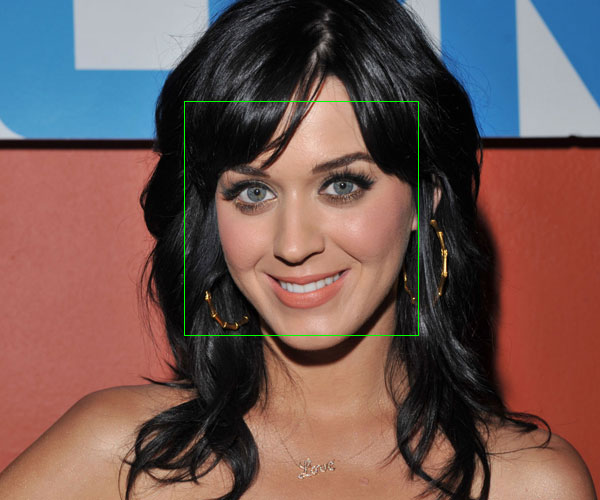

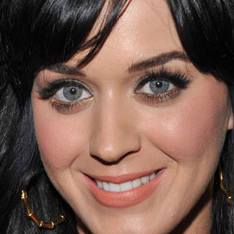

In [ ]:
img = train[0][2]
h,w = img.shape[:2]

faceCascade = cv2.CascadeClassifier(os.path.join(base_path, "haarcascade_frontalface_default.xml"))
img_ = img.copy()
img_gray = cv2.cvtColor(img_, cv2.COLOR_BGR2GRAY)
faces = faceCascade.detectMultiScale(
    img_gray,
    scaleFactor=1.2,
    minNeighbors=5,
    minSize=(30, 30),
    flags=cv2.CASCADE_SCALE_IMAGE
)
for (x, y, w, h) in faces:
    cv2.rectangle(img_, (x, y), (x+w, y+h), (0, 255, 0), 1)
cv2_imshow(img_)

face = img[y:y+h,x:x+w]
cv2_imshow(face)

### Person C: Zoeey Deschanel 
Looks suspiciously similar to Katy Perry (Person A).

Features:
1. White and female
2. Dark, long hair

Differentiating between Katy Perry and Zoeey Deschanel will probably be the hardest challenge

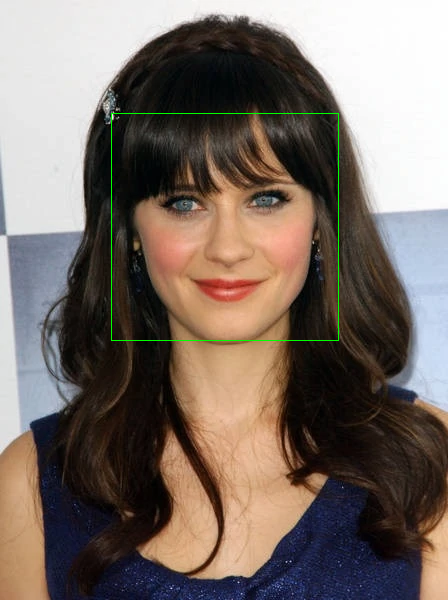

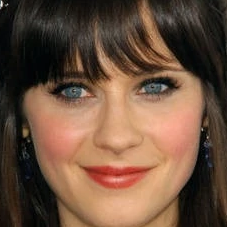

In [ ]:
img = test[2][6]
h,w = img.shape[:2]

faceCascade = cv2.CascadeClassifier(os.path.join(base_path, "haarcascade_frontalface_default.xml"))
img_ = img.copy()
img_gray = cv2.cvtColor(img_, cv2.COLOR_BGR2GRAY)
faces = faceCascade.detectMultiScale(
    img_gray,
    scaleFactor=1.2,
    minNeighbors=5,
    minSize=(30, 30),
    flags=cv2.CASCADE_SCALE_IMAGE
)
for (x, y, w, h) in faces:
    cv2.rectangle(img_, (x, y), (x+w, y+h), (0, 255, 0), 1)
cv2_imshow(img_)

face = img[y:y+h,x:x+w]
cv2_imshow(face)

###Person B: Tom Hiddleston
Features:
1. White male
2. Dark, medium-long hair, often somewhat messy
3. Small beard around his mouth and chin, but not on all pictures

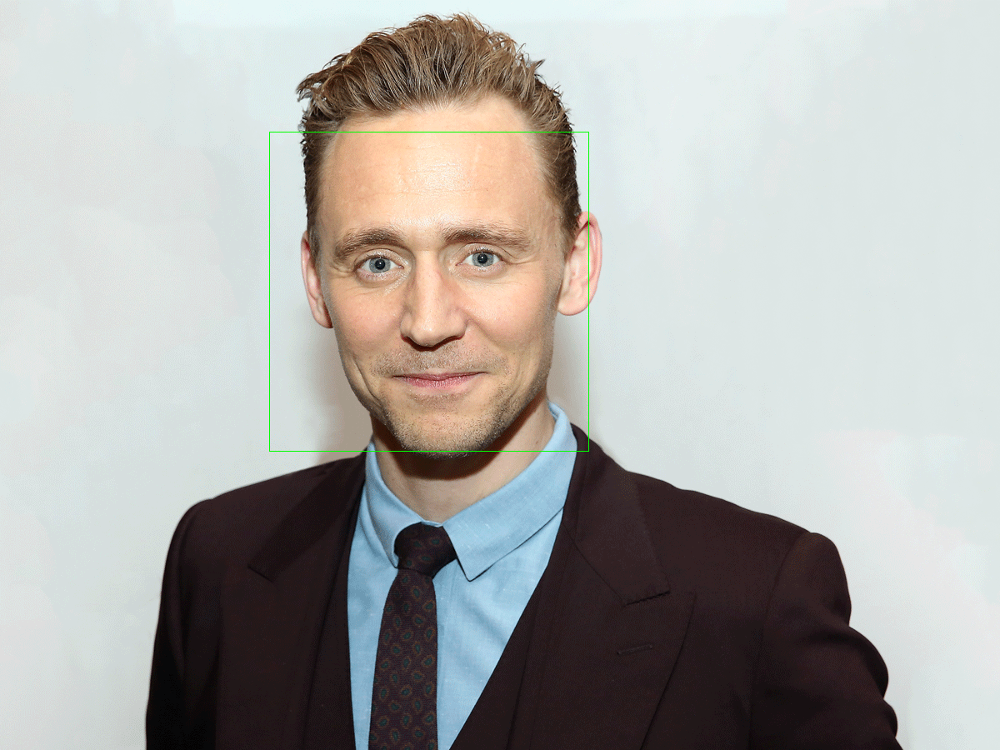

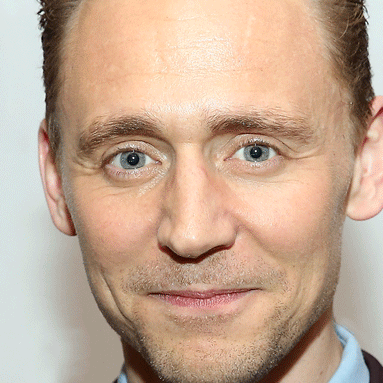

In [ ]:
img = train[1][5]
h,w = img.shape[:2]

faceCascade = cv2.CascadeClassifier(os.path.join(base_path, "haarcascade_frontalface_default.xml"))
img_ = img.copy()
img_gray = cv2.cvtColor(img_, cv2.COLOR_BGR2GRAY)
faces = faceCascade.detectMultiScale(
    img_gray,
    scaleFactor=1.2,
    minNeighbors=5,
    minSize=(30, 30),
    flags=cv2.CASCADE_SCALE_IMAGE
)
for (x, y, w, h) in faces:
    cv2.rectangle(img_, (x, y), (x+w, y+h), (0, 255, 0), 1)
cv2_imshow(img_)

face = img[y:y+h,x:x+w]
cv2_imshow(face)

###Person D: Hugh Laurie
Has similar features to Tom Hiddleston
1. White male
2. Dark, medium-long hair, often somewhat messy
3. Trimmed beard, but rather long on some pictures


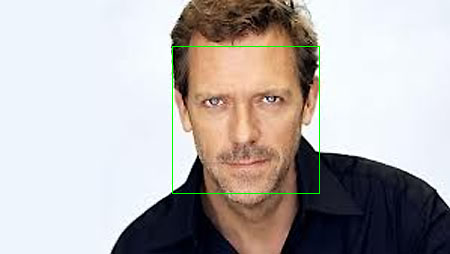

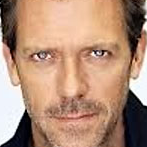

In [ ]:
img = test[3][5]
h,w = img.shape[:2]

faceCascade = cv2.CascadeClassifier(os.path.join(base_path, "haarcascade_frontalface_default.xml"))
img_ = img.copy()
img_gray = cv2.cvtColor(img_, cv2.COLOR_BGR2GRAY)
faces = faceCascade.detectMultiScale(
    img_gray,
    scaleFactor=1.2,
    minNeighbors=5,
    minSize=(30, 30),
    flags=cv2.CASCADE_SCALE_IMAGE
)
for (x, y, w, h) in faces:
    cv2.rectangle(img_, (x, y), (x+w, y+h), (0, 255, 0), 1)
cv2_imshow(img_)

face = img[y:y+h,x:x+w]
cv2_imshow(face)


## Detecting and extracting faces using OpenCV

We use our pretrained Classifier to detect faces at multiple sizes. If a face is detected, we draw a rectangle around it and extract the part of the image that was recognized as being a face.

In [ ]:
faceCascade = cv2.CascadeClassifier(os.path.join(base_path, "haarcascade_frontalface_default.xml"))

for subject in train:
  for img in subject:
    img = resize_to_width(img,400)
    img_ = img.copy()
    img_gray = cv2.cvtColor(img_, cv2.COLOR_BGR2GRAY)
    faces = faceCascade.detectMultiScale(
      img_gray,
      scaleFactor=1.2,
      minNeighbors=5,
      minSize=(30, 30),
      maxSize=(400,400),
      flags=cv2.CASCADE_SCALE_IMAGE
    )
    for (x, y, w, h) in faces:
      cv2.rectangle(img_, (x, y), (x+w, y+h), (0, 255, 0), 1)
    cv2_imshow(img_)

    face = img[y:y+h,x:x+w]
    cv2_imshow(face)


NameError: ignored

Observations: 
1. Detects most of the faces
2. Very high-resolution images often lead to false positives, so we resize first

# Section B: handcrafted features using a histogram of oriented gradients



One way to detect certain objects is by using a 'histogram of oriented gradients'. The aim is to throw away useless information, and retain useful information in a compact way. As seen before, edges and corners contain a lot of information.

This method computes the difference in pixel intensity (the gradient) at all pixels. These values are binned per cell, and normalized per block. Details about this method can be found at: https://www.learnopencv.com/histogram-of-oriented-gradients/. 

Some understanding of the algorithm is necessary to find appropriate parameter values. In openCV, a HOGDescriptor() needs the following attributes:
1. winSize (window size): size of the patch (here: face) in pixels
2. blockSize: size of the blocks to normalize over, in pixels
3. blockStride: amount of pixels that overlap between blocks
4. cellSize: size (in pixels) of each cell
4. nbins: amount of bins over which the orientations are binned

To detect faces at multiple scales, we use a list of different window sizes. Cells are constant at 2x2 pixels, to detect very small edges in the image. This way, we can take small features, such as eyebrows, into account. We choose a block stride of 4x4 pixels, and a block size of 16x16 pixels. 

The following code initializes the parameters, the HOGDescriptors and computes feature vectors of a training face at different sizes.

Our training face for person A: 159x159 pixels


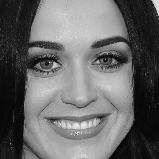

In [ ]:
#https://www.learnopencv.com/histogram-of-oriented-gradients/
blockSize = (64,64)   #Each block is 16x16 pixels = 2x2 cells
blockStride = (16,16)   #Blocks overlap 2 pixels in each direction (step size)
cellSize = (32,32)      #Each cell is 8x8 pixels
nbins = 9             #Number of direction bins

faceCascade = cv2.CascadeClassifier(os.path.join(base_path, "haarcascade_frontalface_default.xml"))

face = resize_to_width(cv2.imread(os.path.join(base_path,"A","train","katy-perry-hot-pic-jpeg-15.jpg")),400)
faces = faceCascade.detectMultiScale(face,scaleFactor=1.2,minNeighbors=5,minSize=(30, 30),maxSize=(300,300),flags=cv2.CASCADE_SCALE_IMAGE)
(x, y, w, h) = faces[0]
training_face_A = cv2.cvtColor(face[y:y+h,x:x+w],cv2.COLOR_BGR2GRAY)
print("Our training face for person A: {}x{} pixels".format(training_face_A.shape[0],training_face_A.shape[0]))
cv2_imshow(training_face_A)

hog_A = cv2.HOGDescriptor((128,128),blockSize,blockStride,cellSize,nbins)

Clearly, edges are very informative when detecting faces. Colors not so much, so we will detect faces in grayscale to reduce the amount of information.


Our training face for person B: 232x232 pixels


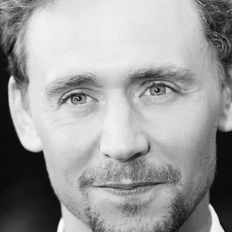

In [ ]:
face = resize_to_width(cv2.imread(os.path.join(base_path,"B","train","3037549_1349862029030.28res_500_500.jpg")),400)
faces = faceCascade.detectMultiScale(face,scaleFactor=1.2,minNeighbors=5,minSize=(30, 30),maxSize=(300,300),flags=cv2.CASCADE_SCALE_IMAGE)
(x, y, w, h) = faces[0]
training_face_B = cv2.cvtColor(face[y:y+h,x:x+w],cv2.COLOR_BGR2GRAY)
print("Our training face for person B: {}x{} pixels".format(training_face_B.shape[0],training_face_B.shape[0]))
cv2_imshow(training_face_B)

To verify if our HOG Descriptor is informative enough, we compute the L2 distance between an unseen face and the training faces. The lowest distance determines which person we have detected.

(900, 1)
Detected Katy Perry


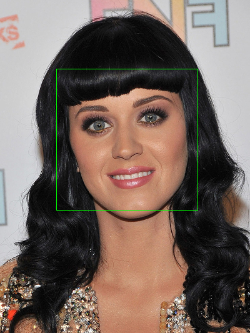

Detected Katy Perry


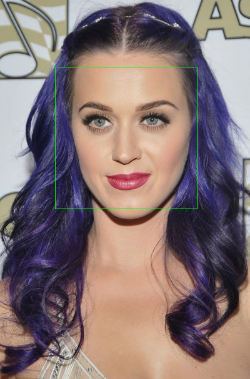

Detected Katy Perry


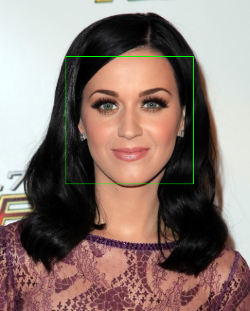

Detected Tom Hiddleston


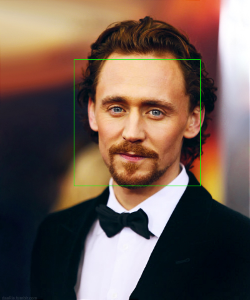

Detected Tom Hiddleston


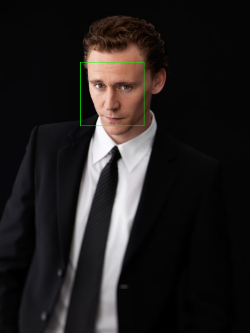

Detected Tom Hiddleston


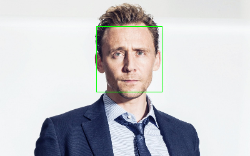

In [ ]:
face_vec1 = hog_A.compute(cv2.resize(training_face_A,(128,128)))
face_vec2 = hog_A.compute(cv2.resize(training_face_B,(128,128)))
print(face_vec1.shape)
discussion_shapes = {}
discussion_shapes["HOG"] = face_vec1.shape

for img in test[0][0:3]+test[1][0:3]:
  img_ = cv2.cvtColor(resize_to_width(img,400),cv2.COLOR_BGR2GRAY)
  faces = faceCascade.detectMultiScale(img_,scaleFactor=1.2,minNeighbors=5,minSize=(30, 30),maxSize=(300,300),flags=cv2.CASCADE_SCALE_IMAGE)
  (x,y,w,h) = faces[0]
  face = img_[y:y+h,x:x+w]
  vec1 = hog_A.compute(cv2.resize(face,(128,128)))
  dist1 = cv2.norm(vec1-face_vec1,cv2.NORM_L2)
  dist2 = cv2.norm(vec1-face_vec2,cv2.NORM_L2)
  if (dist1 < dist2):
    print("Detected Katy Perry")
  else:
    print("Detected Tom Hiddleston")
  img_show = resize_to_width(img,400)
  img_show = cv2.rectangle(img_show,(x,y),(x+w,y+h),(0,255,0))
  cv2_imshow(resize_to_width(img_show,250))
  


# Section C: Building low-dimensional feature vectors using PCA

## Person A and B

First we use the builtin face detector to extract faces from all images.

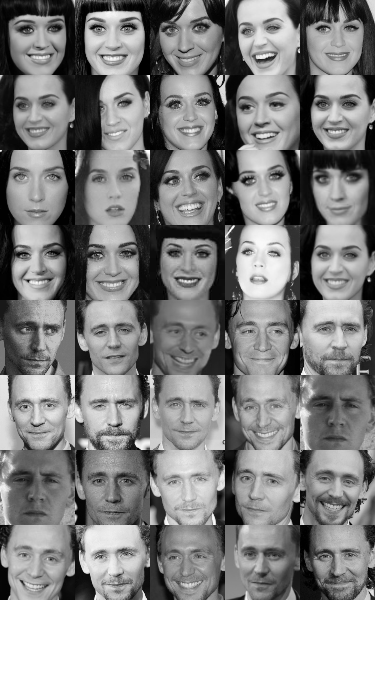

In [ ]:
face_cropped = list()
faceCascade = cv2.CascadeClassifier(os.path.join(base_path, "haarcascade_frontalface_default.xml"))

for subject in train:
  for img in subject:
    h,w = img.shape[:2]
    img_ = resize_to_height(img,400)
    img_gray = cv2.cvtColor(img_, cv2.COLOR_BGR2GRAY)
    faces = faceCascade.detectMultiScale(
    img_gray,
    scaleFactor=1.2,
    minNeighbors=5,
    minSize=(30, 30),
    flags=cv2.CASCADE_SCALE_IMAGE
)

    (x, y, w, h) = faces[0]
    face_cropped.append(cv2.resize(img_gray[y:y+h,x:x+w],(75,75)))


cv2_imshowmany(face_cropped,5,width=75,channels=1)



These images are 75x75px. We convert them into column vectors of dimension (1, 5625) (without loss of data) and combine our training set into a 2D matrix, with all the faces in its rows. 


In [ ]:
face_cropped_vecs = [np.reshape(x,(1, 5625)) for x in face_cropped]
training = np.zeros((len(face_cropped),5625))
for i in range(len(face_cropped_vecs)):
  training[i,:] = face_cropped_vecs[i]

print(training.shape)
discussion_shapes["PCA"] = (1,5625)

(40, 5625)


Now we reduce the features to manageable dimension using sklearn's PCA. This method has the following properties:
1. It uses a (truncated) full SVD. A known result from numerical linear algebra states that SVD is a decomposition method with minimal data loss, at the cost of higher complexity (as opposed to eigenvalue decomposition). Because our training faces are small, and the PCA can be calculated beforehand, this is an acceptable compromise.
2. We do not use normalization (``` whiten = False ```), because very dark and very light parts of the images (such as hair and eyes) convey a lot of information. Normalization would reduce the contrast between these features.
3. The data is centered (mean subtraction) before calculating the SVD. This allows pixels with very low intensity (black pixels) to carry just as much information as very high intensity pixels. 




In [ ]:
pca = PCA(n_components=40,whiten=False)
pca.fit(training)
training_pca = pca.transform(training)


We can now visualize the first 10 eigenfaces: the principal components that were extracted from our data. They are shown in order of importance. 

It appears that the first few components focus on overall lighting. We also see components that capture lips and eyebrows.

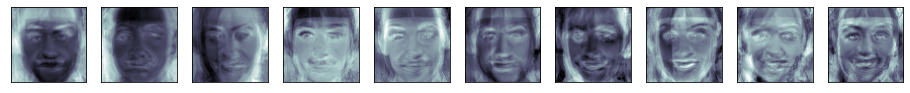

In [ ]:
fig = plt.figure(figsize=(16, 6))
for i in range(10):
    ax = fig.add_subplot(3, 10, i + 1, xticks=[], yticks=[])
    ax.imshow(pca.components_[i].reshape((75,75)),
              cmap=plt.cm.bone)
    

Let's determine how many components we need: we can reconstruct an image using 1, 2, 3, ... components, and see where the data loss is acceptable.

A: Katy Perry


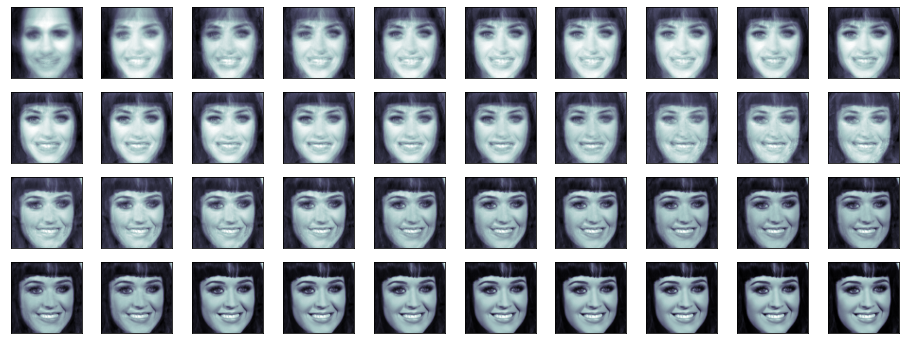

In [ ]:
fig = plt.figure(figsize=(16, 6))

print("A: Katy Perry")
for i in range(40):
  pca = PCA(n_components=i,whiten=False)
  pca.fit(training)
  ax = fig.add_subplot(4, 10, i+1, xticks=[], yticks=[])
  
  plt.imshow(pca.inverse_transform(pca.transform(face_cropped_vecs[0])).reshape((75,75)),cmap=plt.cm.bone)

B: Tom Hiddleston


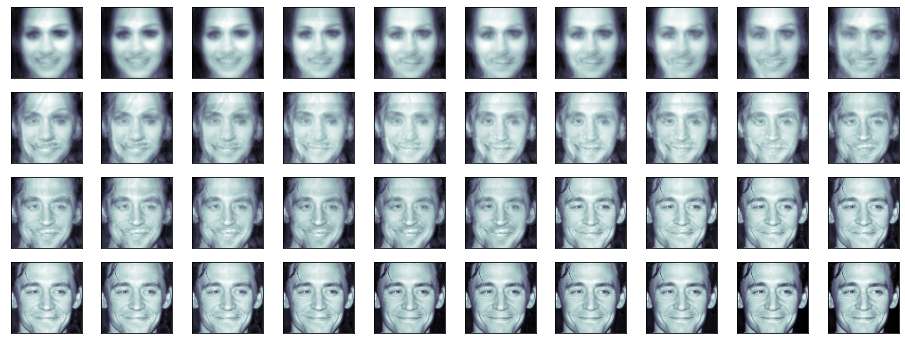

In [ ]:
print("B: Tom Hiddleston")
fig = plt.figure(figsize=(16, 6))

for i in range(40):
  pca = PCA(n_components=i,whiten=False)
  pca.fit(training)
  ax = fig.add_subplot(4, 10, i+1, xticks=[], yticks=[])
  
  plt.imshow(pca.inverse_transform(pca.transform(face_cropped_vecs[23])).reshape((75,75)),cmap=plt.cm.bone)

We conclude that 25 components is enough to capture an image. Unless otherwise stated, we assume that PCA is applied with 25 components.

## Visualization in principal component space

Using Matplotlib, we can visualise the first 2 principal components in a 2D scatterplot. 

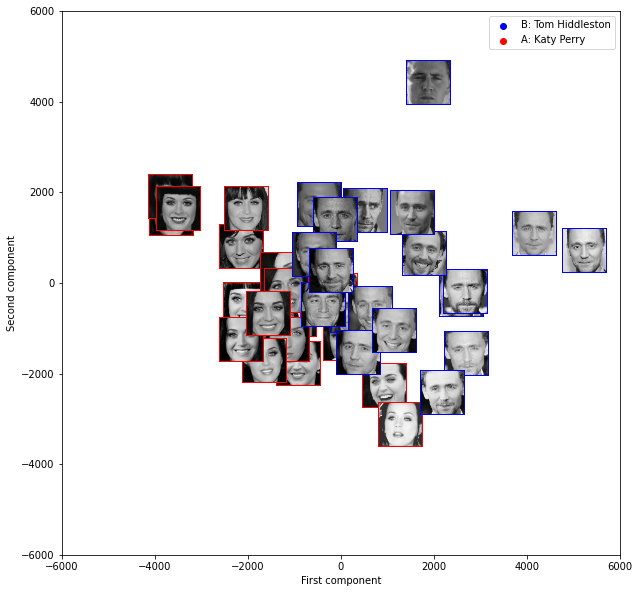

In [ ]:
#Fit PCA to training data
pca = PCA(n_components=25,whiten=False)
pca.fit(training)
xA = list()
xB = list()
yA = list()
yB = list()

#Extract first two principal components
for img in face_cropped_vecs[0:19]:
  xA.append(pca.transform(img)[0][0])
  yA.append(pca.transform(img)[0][1])

for img in face_cropped_vecs[20:]:
  xB.append(pca.transform(img)[0][0])
  yB.append(pca.transform(img)[0][1])

#Scatter points (for legend)
fig = plt.figure(figsize=(10,10))
plt.scatter(xB,yB,c='b',label="B: Tom Hiddleston", zorder=0)
plt.scatter(xA,yA,c='r',label="A: Katy Perry",zorder=0)

#Add colored border and plot images
ax = plt.gca()
artists = []
for x,y, img in zip(xA,yA,face_cropped[0:19]):
  img = cv2.cvtColor(img,cv2.COLOR_BGR2RGB)
  img[0:2,:] = np.array([255,0,0])
  img[:,0:2] = np.array([255,0,0])
  img[:,-2:] = np.array([255,0,0])
  img[-2:,:] = np.array([255,0,0])
  img = OffsetImage(img, zoom=0.6)
  ab = AnnotationBbox(img, (x, y), xycoords='data', frameon=False)
  artists.append(ax.add_artist(ab))

for x,y, img in zip(xB,yB,face_cropped[20:]):
  img = cv2.cvtColor(img,cv2.COLOR_BGR2RGB)
  img[0:2,:] = np.array([0,0,255])
  img[:,0:2] = np.array([0,0,255])
  img[:,-2:] = np.array([0,0,255])
  img[-2:,:] = np.array([0,0,255])

  img = OffsetImage(img, zoom=0.6)
  ab = AnnotationBbox(img, (x, y), xycoords='data', frameon=False)
  artists.append(ax.add_artist(ab))

#Set labels and legend
plt.xlabel("First component")
plt.ylabel("Second component")
plt.xlim((-6000,6000))
plt.ylim((-6000,6000))
plt.legend()

It appears that the first component (X axis) captures lighting, as darker images end up on the left, and darker images on the right. It is not immediately clear what the second component captures.

# Section D: Learning features from data: Transfer learning with VGGFace Model

In this part we are going to rip the benefits of Deep Learning, not by training a Neural Network from scratch, that requires large training datasets and other resources, but by leveraging face-features of a pre-trained Convolutional Neural Network. 

We are going to use the VGGFace Model which was build to complete the task of Face Recognition by extracting features of faces, trained on a very large dataset with millions of pictures of celebrities.

We will apply Transfer Learning and use the pre-trained weights of the VGGFace model. 

For our purposes, we are going to use the same architecture, minus the last softmax layer, in order to obtain the 2622-dimensional Embeddings of the faces.

Before obtaining the model, we should install the right Tensorflow and Keras version.

In [ ]:
!pip install q tensorflow==1.14
!pip install q keras==2.3.1
!pip install keras_vggface

     |████████████████████████████████| 109.2MB 48kB/s 
     |████████████████████████████████| 3.2MB 48.5MB/s 
     |████████████████████████████████| 491kB 43.2MB/s 
  Found existing installation: tensorboard 2.2.0
    Uninstalling tensorboard-2.2.0:
      Successfully uninstalled tensorboard-2.2.0
  Found existing installation: tensorflow-estimator 2.2.0rc0
    Uninstalling tensorflow-estimator-2.2.0rc0:
      Successfully uninstalled tensorflow-estimator-2.2.0rc0
  Found existing installation: tensorflow 2.2.0rc2
    Uninstalling tensorflow-2.2.0rc2:
      Successfully uninstalled tensorflow-2.2.0rc2


## Loading the VGG Model
We will make use of the vgg16 model. One of the available models in the keras_vggface package. 

The pre-trained weights are loaded automatically from the file "rcmalli_vggface_tf_vgg16.h5" .

Below we visualize the model architecture.

In [ ]:
import tensorflow as tf
from tensorflow import keras
from keras.models import Sequential, Model
from keras_vggface.vggface import VGGFace
from tensorflow.keras.applications.vgg16 import VGG16
from tensorflow.keras.applications.vgg16 import preprocess_input, decode_predictions
from tensorflow.keras.utils import plot_model
from tensorflow.keras.preprocessing.image import load_img, img_to_array
from tensorflow.python.keras import backend as k

# Tensorflow model based on the VGG16 architecture
model = VGGFace(model='vgg16')
print(model.summary())


/usr/local/lib/python3.6/dist-packages/tensorflow/python/framework/dtypes.py:516: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
/usr/local/lib/python3.6/dist-packages/tensorflow/python/framework/dtypes.py:517: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
/usr/local/lib/python3.6/dist-packages/tensorflow/python/framework/dtypes.py:518: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
/usr/local/lib/python3.6/dist-packages/tensorflow/python/framework/dtypes.py:519: FutureWarning: Passing (type, 1) or 

Using TensorFlow backend.



580075520/580070376 [==============================] - 12s 0us/step
Model: "vggface_vgg16"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         (None, 224, 224, 3)       0         
_________________________________________________________________
conv1_1 (Conv2D)             (None, 224, 224, 64)      1792      
_________________________________________________________________
conv1_2 (Conv2D)             (None, 224, 224, 64)      36928     
_________________________________________________________________
pool1 (MaxPooling2D)         (None, 112, 112, 64)      0         
_________________________________________________________________
conv2_1 (Conv2D)             (None, 112, 112, 128)     73856     
_________________________________________________________________
conv2_2 (Conv2D)             (None, 112, 112, 128)     147584    
__________________________________________________

In the output layer, a softmax layer is used for recognizing images in WildFaces dataset. 
In order to build our own model, we require embeddings which are output of the last but one layer. 
The pictures are represented by an embedding vector of 2622 dimensions.

In [ ]:
vgg_face = Model(inputs=model.layers[0].input, outputs=model.layers[-2].output)
print(vgg_face.summary())

Model: "model_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         (None, 224, 224, 3)       0         
_________________________________________________________________
conv1_1 (Conv2D)             (None, 224, 224, 64)      1792      
_________________________________________________________________
conv1_2 (Conv2D)             (None, 224, 224, 64)      36928     
_________________________________________________________________
pool1 (MaxPooling2D)         (None, 112, 112, 64)      0         
_________________________________________________________________
conv2_1 (Conv2D)             (None, 112, 112, 128)     73856     
_________________________________________________________________
conv2_2 (Conv2D)             (None, 112, 112, 128)     147584    
_________________________________________________________________
pool2 (MaxPooling2D)         (None, 56, 56, 128)       0   

##Load & preprocess the data
The VGGFace model expects 224x224x3 sized input images. The 3rd dimension refers to number of RGB channels.

First, we extract the faces using the pretrained Cascade Classifier.

For the preprocessing of the image, we:

- resize to expected dimension of 224x224 pixels
- convert pixels to NumPy array
- normalize input in scale [-1, +1]
- apply preprocess_input function provided by Keras

We create two lists for the face embeddings for person A and person B.


Dimensions of training image for person A: 1x224x224x3 pixels
Dimensions of the embeddings of our face images: 1x2622 
Dimensions of the face_embeddings_A list:  (20, 1, 2622)
----------------------------------------------------------
Overview of Training faces for person A


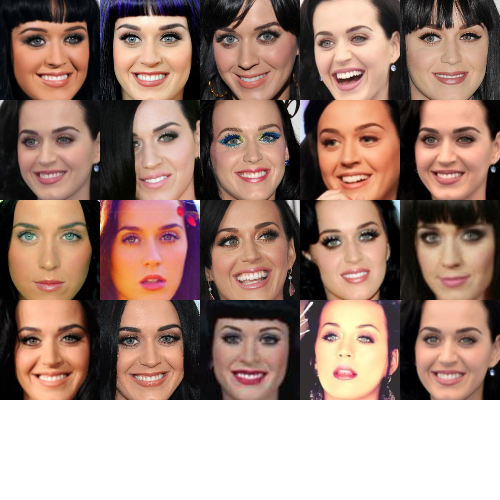

In [ ]:
# Get face embeddings for person A

face_embeddings_A = list()
face_cropped_A = list()
faceCascade = cv2.CascadeClassifier(os.path.join(base_path, "haarcascade_frontalface_default.xml"))

for img in train[0][:]:

  # Extract faces from images
  h,w = img.shape[:2]
  img_ = resize_to_height(img,600)
  img_gray = cv2.cvtColor(img_, cv2.COLOR_BGR2GRAY)

  faces = faceCascade.detectMultiScale(
      img_gray,
      scaleFactor=1.2,
      minNeighbors=5,
      minSize=(30, 30),
      flags=cv2.CASCADE_SCALE_IMAGE
  )

  (x, y, w, h) = faces[0]
  face_cropped_A.append(cv2.resize(img_[y:y+h,x:x+w],(100,100)))

  # Preprocess image
  face = cv2.resize(img_[y:y+h,x:x+w],(224,224))
  crop_img = img_to_array(face)
  crop_img = np.expand_dims(crop_img, axis=0)
  crop_img = preprocess_input(crop_img)

  # Get face embeddings 
  img_encode = vgg_face.predict(crop_img)
  
  face_embeddings_A.append(img_encode)

print("Dimensions of training image for person A: {}x{}x{}x{} pixels".format(crop_img.shape[0],crop_img.shape[1],crop_img.shape[2],crop_img.shape[3]))
print("Dimensions of the embeddings of our face images: {}x{} ".format(img_encode.shape[0],img_encode.shape[1]))
print("Dimensions of the face_embeddings_A list: ",np.shape(face_embeddings_A))  
print("----------------------------------------------------------")

discussion_shapes["TL"] = (1,2622)
# Visualize Training Faces for person A
print("Overview of Training faces for person A")
cv2_imshowmany(face_cropped_A,5,width=100,channels=3)

Dimensions of training image for person B: 1x224x224x3 pixels
Dimensions of the embeddings of our face images: 1x2622 
Dimensions of the face_embeddings_B list:  (20, 1, 2622)
----------------------------------------------------------
Overview of Training faces for person B


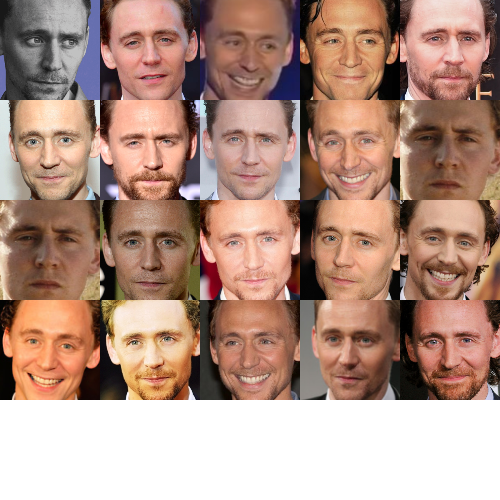

In [ ]:
# Get face embeddings for person B

face_embeddings_B = list()
face_cropped_B = list()
faceCascade = cv2.CascadeClassifier(os.path.join(base_path, "haarcascade_frontalface_default.xml"))

for img in train[1][:]:

  # Extract faces from images
  h,w = img.shape[:2]
  img_ = resize_to_height(img,600)
  img_gray = cv2.cvtColor(img_, cv2.COLOR_BGR2GRAY)

  faces = faceCascade.detectMultiScale(
      img_gray,
      scaleFactor=1.2,
      minNeighbors=5,
      minSize=(30, 30),
      flags=cv2.CASCADE_SCALE_IMAGE
  )

  (x, y, w, h) = faces[0]
  face_cropped_B.append(cv2.resize(img_[y:y+h,x:x+w],(100,100)))

  # Preprocess image
  face = cv2.resize(img_[y:y+h,x:x+w],(224,224))
  crop_img = img_to_array(face)
  crop_img = np.expand_dims(crop_img, axis=0)
  crop_img = preprocess_input(crop_img)

  # Get face embeddings 
  img_encode = vgg_face.predict(crop_img)
  
  face_embeddings_B.append(img_encode)

print("Dimensions of training image for person B: {}x{}x{}x{} pixels".format(crop_img.shape[0],crop_img.shape[1],crop_img.shape[2],crop_img.shape[3]))
print("Dimensions of the embeddings of our face images: {}x{} ".format(img_encode.shape[0],img_encode.shape[1]))
print("Dimensions of the face_embeddings_B list: ", np.shape(face_embeddings_B)) 
print("----------------------------------------------------------")

# Visualize Training Faces for person B
print("Overview of Training faces for person B")
cv2_imshowmany(face_cropped_B,5,width=100,channels=3)

##Visualization with t-SNE
T-distributed Stochastic Neighbor Embedding (t-SNE) is a machine learning algorithm for visualization. It is a nonlinear dimensionality reduction technique well-suited for embedding high-dimensional data for visualization in a low-dimensional space of two or three dimensions. Specifically, it models each high-dimensional object by a two- or three-dimensional point in such a way that similar objects are modeled by nearby points and dissimilar objects are modeled by distant points with high probability.

The t-SNE algorithm comprises two main stages. First, t-SNE constructs a probability distribution over pairs of high-dimensional objects in such a way that similar objects have a high probability of being picked while dissimilar points have an extremely small probability of being picked. Second, t-SNE defines a similar probability distribution over the points in the low-dimensional map, and it minimizes the Kullback–Leibler divergence (KL divergence) between the two distributions with respect to the locations of the points in the map. Note that while the original algorithm uses the Euclidean distance between objects as the base of its similarity metric, this should be changed as appropriate.

Source: https://en.wikipedia.org/wiki/T-distributed_stochastic_neighbor_embedding

For the implementation we fit our data into the TSNE function available in Skicit-Learn library.

In [ ]:
# Import the libraries
import numpy as np
import sklearn
from sklearn.manifold import TSNE

# We'll use matplotlib for graphics.
import matplotlib.pyplot as plt
import matplotlib.patheffects as PathEffects
import matplotlib

# We import seaborn to make nice plots.
import seaborn as sns
sns.set_style('darkgrid')
sns.set_palette('muted')
sns.set_context("notebook", font_scale=1.5,
                rc={"lines.linewidth": 2.5})

# Random state
RS = 20150101

/usr/local/lib/python3.6/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


Dimensions of X list, containing Embeddings of person A and person B: (40, 2622)


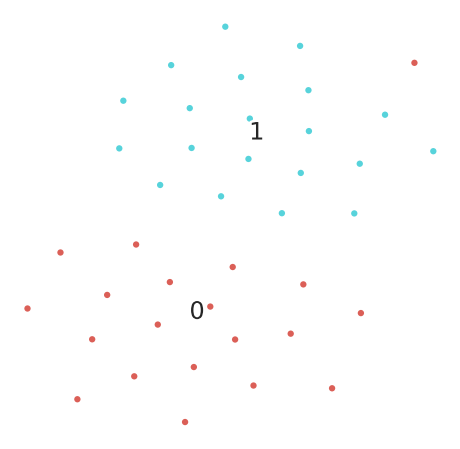

In [ ]:
# Create an X list that contains the Embeddings of person A and person B
# We will use this later on for our classifier
X_train_tl = np.concatenate((np.squeeze(face_embeddings_A, axis=1), 
                    np.squeeze(face_embeddings_B, axis=1)), axis=0)

print("Dimensions of X list, containing Embeddings of person A and person B:", np.shape(X_train_tl))

# Create a y_train array that contains labels: 0 for Katy Perry, 1 for Tom Hiddleston
y_train_tl = list()
for i in range(40):
  if i < 20:
    y_train_tl.append(0)
  else:
    y_train_tl.append(1)

y_train_tl = np.array(y_train_tl)

train_faces_proj = TSNE(random_state=RS).fit_transform(X_train_tl)

# Here is a utility function used to display the transformed dataset.
# The color of each point refers to the actual digit
# This information was not used by the dimensionality reduction algorithm

def scatter(x, colors, nlabels=2):
    # We choose a color palette with seaborn.
    palette = np.array(sns.color_palette('hls', nlabels))
    
    # We create a scatter plot
    f = plt.figure(figsize=(8,8))
    ax = plt.subplot(aspect='equal')
    sc = ax.scatter(x[:,0], x[:,1], lw=0, s=40,
                    c=palette[colors.astype(np.int)])
    plt.xlim(-25, 25)
    plt.ylim(-25, 25)
    ax.axis('off')
    ax.axis('tight')
    
    # We add the labels for each person
    txts = []
    for i in range(nlabels):
        # Position of each label
        xtext, ytext = np.median(x[colors == i, :], axis=0)
        txt = ax.text(xtext, ytext, str(i), fontsize=24)
        txt.set_path_effects([
            PathEffects.Stroke(linewidth=5, foreground='w'),
            PathEffects.Normal()])
        txts.append(txt)
        
    return f, ax, sc, txts

# Here is the result
scatter(train_faces_proj, y_train_tl)
plt.savefig('./tsne-generated.png', dpi=120)

# Section E: Exploiting Feature Representations

##Histogram of oriented gradients: Classification
We reuse the HOG Descriptor we made in section B.

In [ ]:
print(hog_A)

<HOGDescriptor 0x7f339625bb10>


Just like before, we resize all test images to be 400 pixels wide and convert them to grayscale. We then compute to what degree they match our training faces by computing the L2 difference between the feature vector computed on the training face, and the test face. 

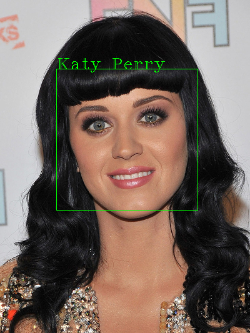

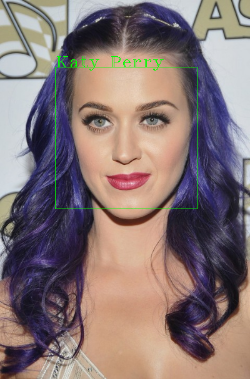

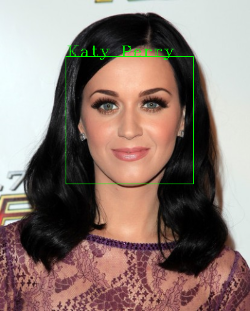

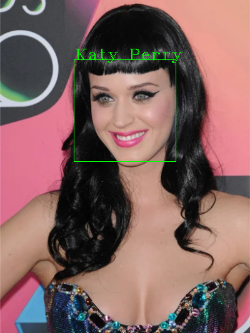

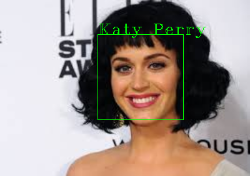

...

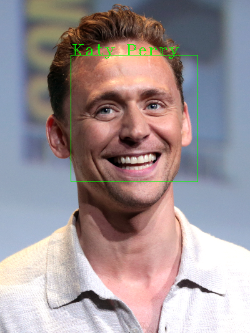

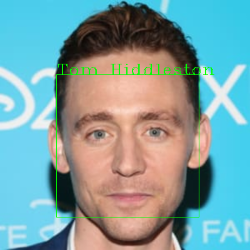

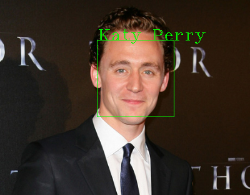

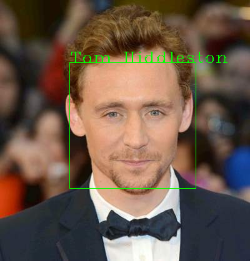

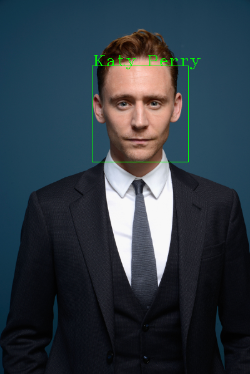

['A', 'A', 'A', 'A', 'A', 'A', 'A', 'A', 'A', 'A', 'B', 'B', 'B', 'A', 'A', 'A', 'B', 'A', 'B', 'A']


In [ ]:
face_vec1 = hog_A.compute(cv2.resize(training_face_A,(128,128)))
face_vec2 = hog_A.compute(cv2.resize(training_face_B,(128,128)))

results = list()
for img in test[0]+test[1]:
  img_ = cv2.cvtColor(resize_to_width(img,400),cv2.COLOR_BGR2GRAY)
  faces = faceCascade.detectMultiScale(img_,scaleFactor=1.2,minNeighbors=5,minSize=(30, 30),maxSize=(300,300),flags=cv2.CASCADE_SCALE_IMAGE)
  (x,y,w,h) = faces[0]
  face = img_[y:y+h,x:x+w]
  vec1 = hog_A.compute(cv2.resize(face,(128,128)))

  dist1 = cv2.norm(vec1-face_vec1,cv2.NORM_L2)
  dist2 = cv2.norm(vec1-face_vec2,cv2.NORM_L2)
  if (dist1 < dist2):
    p = "Katy Perry"
    results.append("A")
  else:
    p = "Tom Hiddleston"
    results.append("B")

  img_show = resize_to_width(img,400)
  img_show = cv2.rectangle(img_show,(x,y),(x+w,y+h),(0,255,0))
  img_show = cv2.putText(img_show,p,(x,y),cv2.FONT_HERSHEY_COMPLEX_SMALL,1.3,(0,255,0))
  cv2_imshow(resize_to_width(img_show,250))

print(results)

The mean accuracy is then computed as the number of correct classifications, divided by the number of test images (in this case 20).

In [ ]:
expected = ["A","A","A","A","A","A","A","A","A","A","B","B","B","B","B","B","B","B","B","B"]
correct = 0
n = len(expected)

for i in range(n):
  if results[i] == expected[i]:
    correct += 1

print("Mean accuracy: {}".format(correct/n))
discussion_results["HOG_classification"] = correct/n

Mean accuracy: 0.75


To show that our classifier is precise enough to differentiate between person A and person C, or person B and person D, we need a quantitative measure of class probabilities. In this case, we can compare the distance between a test face and the training faces. 

For person C, we expect it to be close to the training face for A, but generally not as close as test images of person A. 

In [ ]:
face_vec1 = hog_A.compute(cv2.resize(training_face_A,(128,128)))
face_vec2 = hog_A.compute(cv2.resize(training_face_B,(128,128)))

#Measure distances to face A
dist_A = list()

#Measure distances to face B
dist_B = list()

results = list()
for img in test[0]+test[1]+test[2]+test[3]:
  img_ = cv2.cvtColor(resize_to_width(img,400),cv2.COLOR_BGR2GRAY)
  faces = faceCascade.detectMultiScale(img_,scaleFactor=1.2,minNeighbors=5,minSize=(30, 30),maxSize=(300,300),flags=cv2.CASCADE_SCALE_IMAGE)
  (x,y,w,h) = faces[0]
  if np.mean(img) == np.mean(test[2][2]):
    (x,y,w,h) = faces[1]
  face = img_[y:y+h,x:x+w]
  vec = hog_A.compute(cv2.resize(face,(128,128)))

  dist_A.append(cv2.norm(vec-face_vec1,cv2.NORM_L2))
  dist_B.append(cv2.norm(vec-face_vec2,cv2.NORM_L2))

We visualize these distances below. 

[1.848465024416456, 1.885762550793888, 2.0551375683758226, 1.9364518666603245, 1.890052113040203, 2.1998977948910317, 1.9469522567837965, 1.842267635129156, 1.832008483092718, 1.949089889859797]


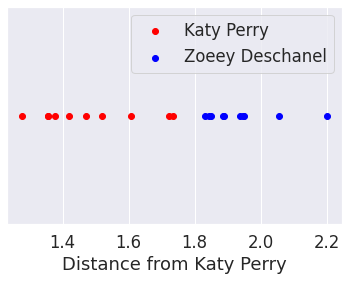

In [ ]:
plt.scatter(dist_A[0:10],np.zeros((1,10)),c='r', label="Katy Perry")
plt.scatter(dist_A[20:30],np.zeros((1,10)),c='b', label="Zoeey Deschanel")
plt.legend()
plt.ylabel("")
plt.xlabel("Distance from Katy Perry")
plt.yticks([])
print(dist_A[20:30])

We see that there is a clear separation between Katy Perry and Zoeey Deschanel: the HOG descriptor is able to tell the difference between the two.

For Tom Hiddleston and Hugh Laurie, the difference is not so apparent. 

[1.848465024416456, 1.885762550793888, 2.0551375683758226, 1.9364518666603245, 1.890052113040203, 2.1998977948910317, 1.9469522567837965, 1.842267635129156, 1.832008483092718, 1.949089889859797]


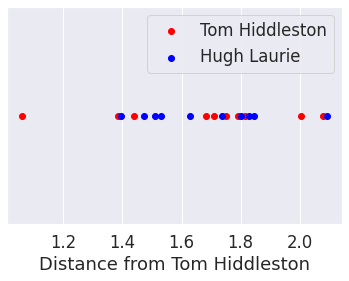

In [ ]:
plt.scatter(dist_B[10:20],np.zeros((1,10)),c='r', label="Tom Hiddleston")
plt.scatter(dist_B[30:40],np.zeros((1,10)),c='b', label="Hugh Laurie")
plt.legend()
plt.ylabel("")
plt.xlabel("Distance from Tom Hiddleston")
plt.yticks([])
print(dist_A[20:30])

## Histogram of oriented gradients: Identification

In this section we compute the feature representations of all training images, and use K-nearest neighbors to identify a person on our test images.

First we extract all faces.

In [ ]:
faces_extracted = list()
for img in train[0]+train[1]:
  img_ = cv2.cvtColor(resize_to_width(img,400),cv2.COLOR_BGR2GRAY)
  faces = faceCascade.detectMultiScale(img_,scaleFactor=1.2,minNeighbors=5,minSize=(30, 30),maxSize=(300,300),flags=cv2.CASCADE_SCALE_IMAGE)
  (x,y,w,h) = faces[0]
  faces_extracted.append(img_[y:y+h,x:x+w])

Next, we resize the faces to 128x128 to match our HOG descriptor, and calculate all feature vectors

In [ ]:
feature_vecs = np.array([hog_A.compute(cv2.resize(face,(128,128))) for face in faces_extracted])
feature_vecs = np.reshape(feature_vecs,(40,900))

Now we can initialize the KNN classifier.

In [ ]:
n = 2
y = np.zeros(40)
y[20:40] = 1
knn = KNeighborsClassifier(n).fit(np.array(feature_vecs),y)

A new image undergoes the same preprocessing steps (i.e. extract face, resize to 128x128, convert to grayscale, compute HOG, reshape to vector). Prediction is then very straightforward.

In [ ]:
face_extracted_vecs = list()

for img in test[0]+test[1]:
  img_ = cv2.cvtColor(resize_to_width(img,400),cv2.COLOR_BGR2GRAY)
  faces = faceCascade.detectMultiScale(img_,scaleFactor=1.2,minNeighbors=5,minSize=(30, 30),maxSize=(300,300),flags=cv2.CASCADE_SCALE_IMAGE)
  (x,y,w,h) = faces[0]
  #Extract face, resize
  face_extracted = cv2.resize(img_[y:y+h,x:x+w],(128,128))
  face_extracted = hog_A.compute(face_extracted)
  face_extracted_vecs.append(np.reshape(face_extracted,(1,900)))

We can now easily predict classes for our test image.

Detected Katy Perry


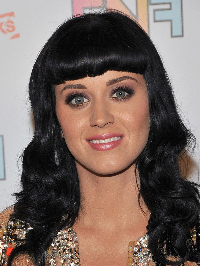

Detected Katy Perry


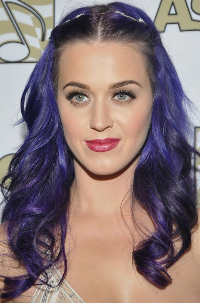

Detected Katy Perry


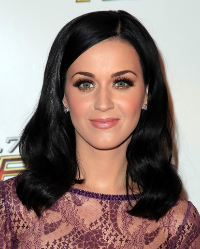

Detected Katy Perry


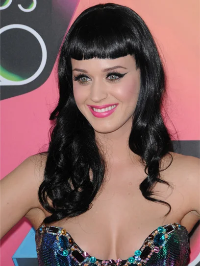

Detected Katy Perry


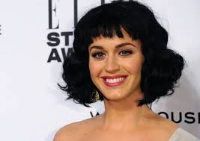

Detected Katy Perry


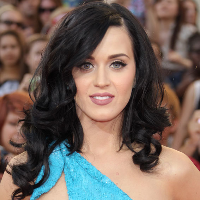

Detected Katy Perry


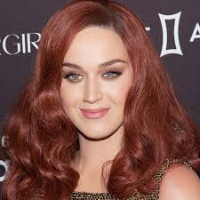

Detected Katy Perry


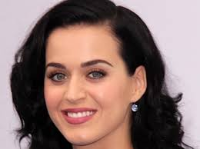

Detected Katy Perry


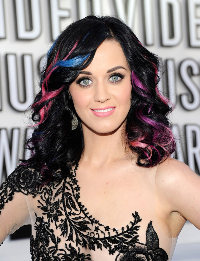

Detected Katy Perry


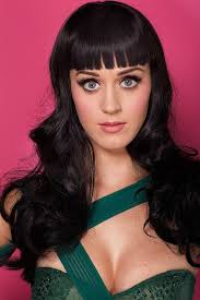

Detected Katy Perry


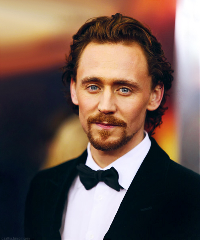

Detected Tom Hiddleston


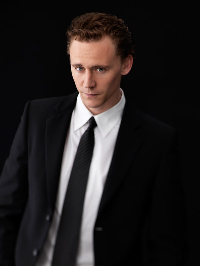

Detected Tom Hiddleston


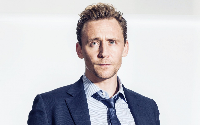

Detected Tom Hiddleston


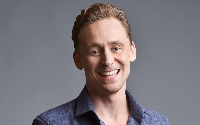

Detected Tom Hiddleston


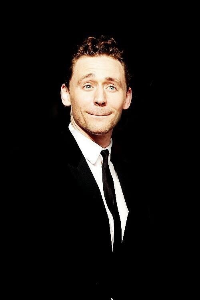

Detected Tom Hiddleston


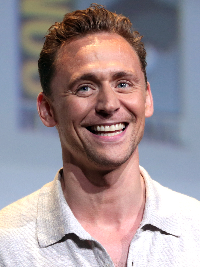

Detected Tom Hiddleston


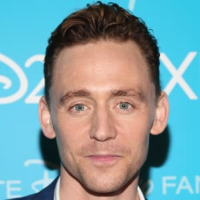

Detected Tom Hiddleston


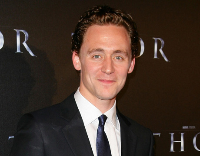

Detected Tom Hiddleston


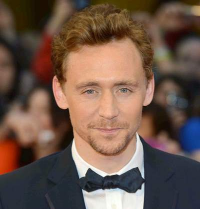

Detected Tom Hiddleston


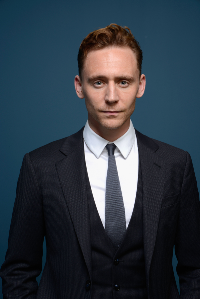

In [ ]:
results = list()
for i in range(20):
  test_image = face_extracted_vecs[i]
  pred = knn.predict(test_image)[0]
  results.append(pred)
  if pred == 0:
    person = "Katy Perry"
  else:
    person = "Tom Hiddleston"

  print("Detected {}".format(person))
  cv2_imshow(resize_to_width((test[0]+test[1])[i],200))

Finally, we compute the mean accuracy.

In [ ]:
expected = [0,0,0,0,0,0,0,0,0,0,1,1,1,1,1,1,1,1,1,1]
correct = 0
n = len(expected)

for i in range(n):
  if results[i] == expected[i]:
    correct += 1

print("Mean accuracy: {}".format(correct/n))
discussion_results["HOG_identification"] = correct/n

Mean accuracy: 0.95


To show how the HOG Descriptor performs when doing identification using KNN, we show the average distance to the K closest images for each test image. We expect Katy Perry and Tom Hiddleston to be very close to their K neighbors, and Zooey Deschanel and Hugh Laurie to be further. Let's visualize this. A KD-tree can be used to quickly lookup neighbors.

In [ ]:
tree = KDTree(np.array(feature_vecs), leaf_size=2)

We apply the same preprocessing to our new test images as before, and calculate the mean distance to its 2 nearest neighbors.

In [ ]:
face_extracted_vecs = list()
avg_dist = list()

for img in test[0]+test[1]+test[2]+test[3]:
  img_ = cv2.cvtColor(resize_to_width(img,400),cv2.COLOR_BGR2GRAY)
  faces = faceCascade.detectMultiScale(img_,scaleFactor=1.2,minNeighbors=5,minSize=(30, 30),maxSize=(300,300),flags=cv2.CASCADE_SCALE_IMAGE)
  (x,y,w,h) = faces[0]
  #Extract face, resize
  face_extracted = cv2.resize(img_[y:y+h,x:x+w],(128,128))
  face_extracted = hog_A.compute(face_extracted)
  face_extracted_vec = np.reshape(face_extracted,(1,900))
  dist, ind = tree.query(face_extracted_vec,k=2)
  avg_dist.append(np.mean(dist))

(-1.0, 2.0)

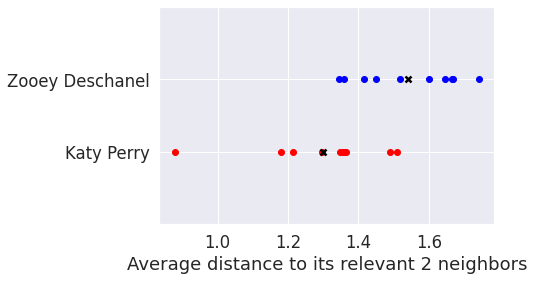

In [ ]:
plt.scatter(avg_dist[0:10],np.zeros((1,10)),c='r', label="Katy Perry")
plt.scatter([np.mean(avg_dist[0:10])],[0],marker='x',c = 'black')
plt.scatter(avg_dist[20:30],np.ones((1,10)),c='b', label="Zoeey Deschanel")
plt.scatter([np.mean(avg_dist[20:30])],[1],marker='x',c = 'black')
plt.ylabel("")
plt.xlabel("Average distance to its relevant 2 neighbors")
plt.yticks([0,1],["Katy Perry","Zooey Deschanel"])
plt.ylim([-1,2])

We see that test images of Katy Perry lie closer to training images of Katy Perry (on average). The same visualization is done for Tom Hiddleston and Hugh Laurie.

(-1.0, 2.0)

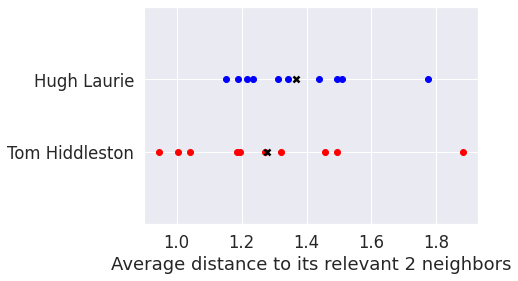

In [ ]:
plt.scatter(avg_dist[10:20],np.zeros((1,10)),c='r', label="Tom Hiddleston")
plt.scatter([np.mean(avg_dist[10:20])],[0],marker='x',c = 'black')
plt.scatter(avg_dist[30:40],np.ones((1,10)),c='b', label="Hugh Laurie")
plt.scatter([np.mean(avg_dist[30:40])],[1],marker='x',c = 'black')
plt.ylabel("")
plt.xlabel("Average distance to its relevant 2 neighbors")
plt.yticks([0,1],["Tom Hiddleston","Hugh Laurie"])
plt.ylim([-1,2])

Again, on average, test images of Tom Hiddleston lie closer to training images of Tom Hiddleston than test images of Hugh Laurie. The difference is a bit smaller than before, though.

##Principal Component analysis: Classification

When building feature representations using PCA, we reduced the number of dimensions to 25, whilst minimizing the information loss. For classification problems in relatively low-dimensional spaces, support vector machines perform extremely well.


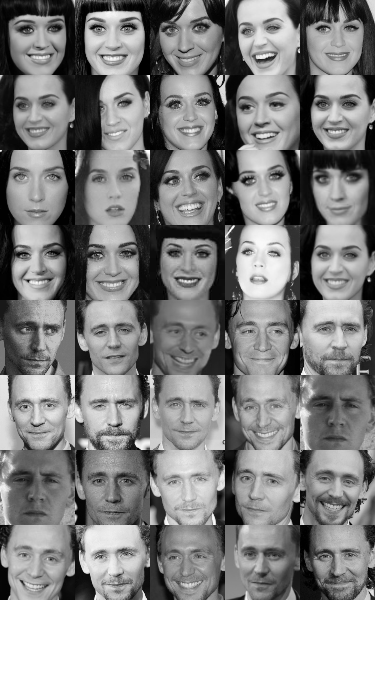

(40, 5625)


In [ ]:
cv2_imshowmany(face_cropped,5,width=75,channels=1)
print(training.shape)

Let's create a new PCA with 25 components, and fit our training data


In [ ]:
pca = PCA(n_components=25,whiten=False)
pca.fit(training)

PCA(copy=True, iterated_power='auto', n_components=25, random_state=None,
    svd_solver='auto', tol=0.0, whiten=False)

We can map our training faces to these 25 components by using pca.transform(). This transformed data will be the input to the SVM.


In [ ]:
x_train = pca.transform(training)
y_train = [0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1]

Now we create a SVM, and fit it to our training data.


In [ ]:
clf = svm.SVC(probability=True)
clf.fit(x_train,y_train)

SVC(C=1.0, break_ties=False, cache_size=200, class_weight=None, coef0=0.0,
    decision_function_shape='ovr', degree=3, gamma='scale', kernel='rbf',
    max_iter=-1, probability=True, random_state=None, shrinking=True, tol=0.001,
    verbose=False)

Classifying new instances is very easy: just extract the faces, transform them using pca.transform() and let the SVM decide.


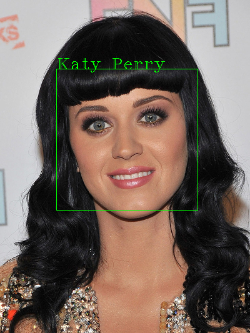

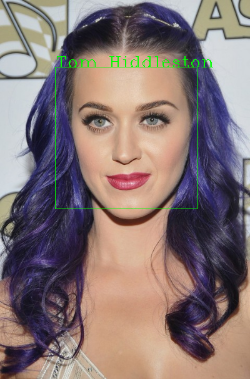

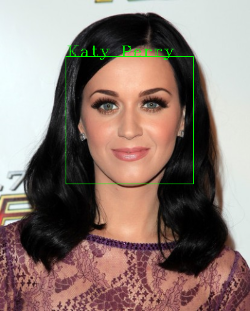

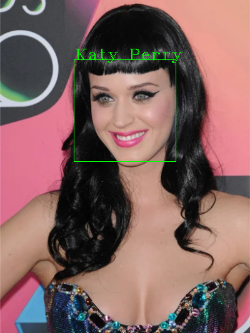

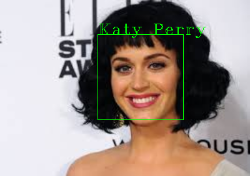

...

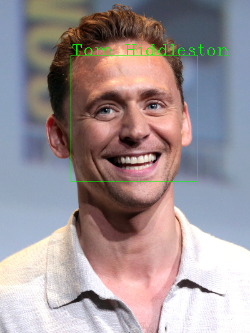

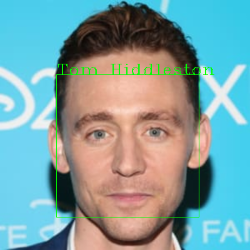

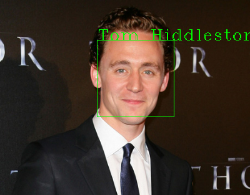

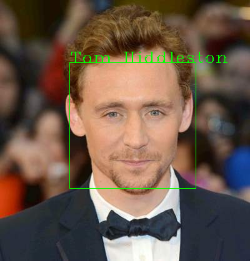

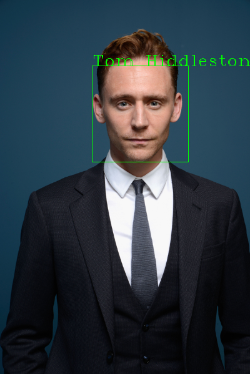

[0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]


In [ ]:
results = list()
for img in test[0]+test[1]:
  img_ = cv2.cvtColor(resize_to_width(img,400),cv2.COLOR_BGR2GRAY)
  faces = faceCascade.detectMultiScale(img_,scaleFactor=1.2,minNeighbors=5,minSize=(30, 30),maxSize=(300,300),flags=cv2.CASCADE_SCALE_IMAGE)
  (x,y,w,h) = faces[0]
  face = img_[y:y+h,x:x+w]

  res = 0
  face = cv2.resize(face,(75,75))
  face_vec = np.reshape(face,(1, 5625))
  face_vec_transformed = pca.transform(face_vec)

  res = clf.predict(face_vec_transformed)

  if res == 0:
    p = "Katy Perry"
    results.append(res[0])
  else:
    p = "Tom Hiddleston"
    results.append(res[0])
  img_show = resize_to_width(img,400)
  img_show = cv2.rectangle(img_show,(x,y),(x+w,y+h),(0,255,0))
  img_show = cv2.putText(img_show,p,(x,y),cv2.FONT_HERSHEY_COMPLEX_SMALL,1.3,(0,255,0))
  cv2_imshow(resize_to_width(img_show,250))

print(results)

Again, we compute the mean accuracy.

In [ ]:
expected = [0,0,0,0,0,0,0,0,0,0,1,1,1,1,1,1,1,1,1,1]
correct = 0
n = len(expected)
for i in range(n):
  if results[i] == expected[i]:
    correct += 1

print("Mean accuracy: {}".format(correct/n))
discussion_results["PCA_classification"] = correct/n

Mean accuracy: 0.95


To see whether the SVM can tell the difference between similar looking people, we visualize the class probabilities.

(-1.0, 2.0)

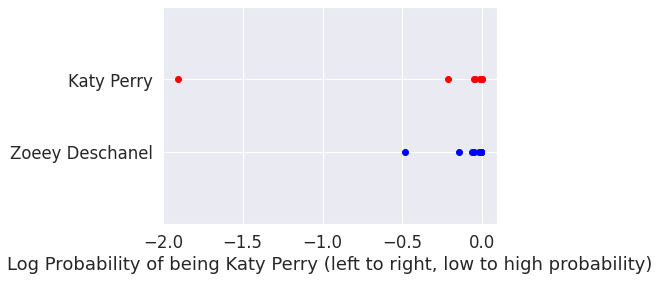

In [ ]:
probs = list()
for img in test[0]+test[1]+test[2]+test[3]:
  img_ = cv2.cvtColor(resize_to_width(img,400),cv2.COLOR_BGR2GRAY)
  faces = faceCascade.detectMultiScale(img_,scaleFactor=1.2,minNeighbors=5,minSize=(30, 30),maxSize=(300,300),flags=cv2.CASCADE_SCALE_IMAGE)
  (x,y,w,h) = faces[0]
  face = img_[y:y+h,x:x+w]

  face = cv2.resize(face,(75,75))
  face_vec = np.reshape(face,(1, 5625))
  face_vec_transformed = pca.transform(face_vec)

  res = clf.predict_log_proba(face_vec_transformed)
  probs.append(res)


plt.scatter([prob[0][0] for prob in probs[0:10]],np.ones((1,10)),c='r', label="Katy Perry")
plt.scatter([prob[0][0] for prob in probs[20:30]],np.zeros((1,10)),c='b', label="Zoeey Deschanel")
plt.ylabel("")
plt.xlabel("Log Probability of being Katy Perry (left to right, low to high probability)")
plt.yticks([0,1],["Zoeey Deschanel","Katy Perry"])
plt.ylim([-1,2])

This time, the classifier gives higher probabilities the right class, but the difference is not as clear as before. Note that we plotted the log(probability) to magnify the difference. We also spot a clear outlier: the following image.


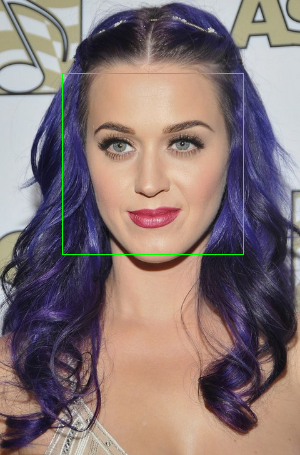

In [ ]:
img = resize_to_width(test[0][1],300)
faces = faceCascade.detectMultiScale(img,scaleFactor=1.2,minNeighbors=5,minSize=(30, 30),maxSize=(300,300),flags=cv2.CASCADE_SCALE_IMAGE)
(x,y,w,h) = faces[0]
img_show = cv2.rectangle(img,(x,y),(x+w,y+h),(0,255,0))
cv2_imshow(img_show)

It is not clear why the SVM is convinced (87%!) that this is NOT Katy Perry.

For C and D, we create a similar visualization.

[1.848465024416456, 1.885762550793888, 2.0551375683758226, 1.9364518666603245, 1.890052113040203, 2.1998977948910317, 1.9469522567837965, 1.842267635129156, 1.832008483092718, 1.949089889859797]


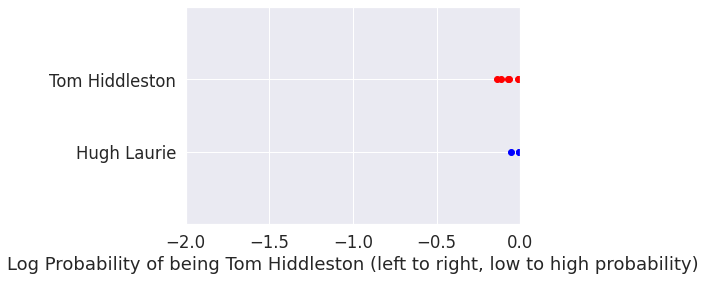

In [ ]:
plt.scatter([prob[0][1] for prob in probs[10:20]],np.ones((1,10)),c='r', label="Tom Hiddleston")
plt.scatter([prob[0][1] for prob in probs[30:40]],np.zeros((1,10)),c='b', label="Hugh Laurie")
plt.ylabel("")
plt.xlabel("Log Probability of being Tom Hiddleston (left to right, low to high probability)")
plt.yticks([0,1],["Hugh Laurie","Tom Hiddleston"])
plt.ylim([-1,2])
plt.xlim([-2,0])
print(dist_A[20:30])

This time, the SVM is not able to predict Tom Hiddleston with higher probabilities. Even worse, Hugh Laurie is often ranked 'more Tom Hiddleston' than Tom Hiddleston himself! 

## Principal Component analysis: Identification

The only difference when doing identification instead of classification is the model we use. In this section, a KNN classifier will be given the input vectors from our training dataset. We will be using the same PCA as before.

In [ ]:
print(pca)

PCA(copy=True, iterated_power='auto', n_components=25, random_state=None,
    svd_solver='auto', tol=0.0, whiten=False)


Now we can create a KNN classifier and fit it to the training data.

In [ ]:
n = 2

x = pca.transform(training)
y = np.zeros(40)
y[20:40] = 1
knn = KNeighborsClassifier(n).fit(np.array(x),y)
tree = KDTree(np.array(x), leaf_size=2)


Prediction is now done by applying the same steps to the training images: convert to grayscale, extract face, resize to 75x75px, convert to vector and transform using the PCA. We then let the KNN classifier decide which person is in the picture.

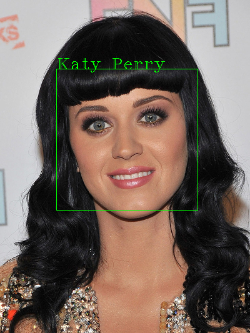

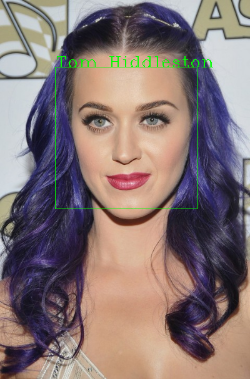

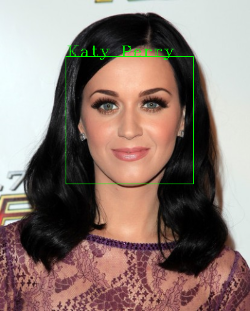

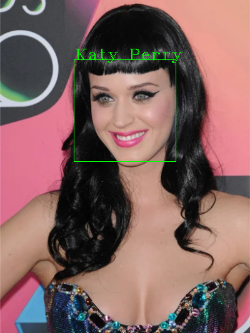

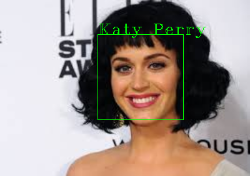

...

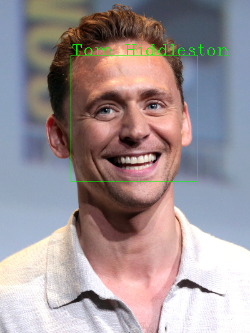

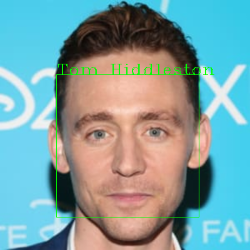

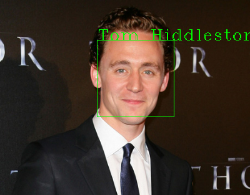

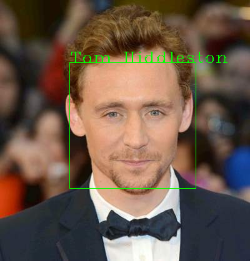

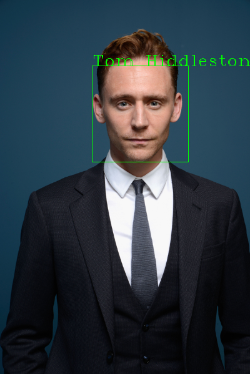

[0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0]


In [ ]:
results = list()
for img in test[0]+test[1]:
  img_ = cv2.cvtColor(resize_to_width(img,400),cv2.COLOR_BGR2GRAY)
  faces = faceCascade.detectMultiScale(img_,scaleFactor=1.2,minNeighbors=5,minSize=(30, 30),maxSize=(300,300),flags=cv2.CASCADE_SCALE_IMAGE)
  (x,y,w,h) = faces[0]
  face = img_[y:y+h,x:x+w]

  res = 0
  face = cv2.resize(face,(75,75))
  face_vec = np.reshape(face,(1, 5625))
  face_vec_transformed = pca.transform(face_vec)

  res = knn.predict(face_vec_transformed)

  if res == 0:
    p = "Katy Perry"
    results.append(res[0])
  else:
    p = "Tom Hiddleston"
    results.append(res[0])
  img_show = resize_to_width(img,400)
  img_show = cv2.rectangle(img_show,(x,y),(x+w,y+h),(0,255,0))
  img_show = cv2.putText(img_show,p,(x,y),cv2.FONT_HERSHEY_COMPLEX_SMALL,1.3,(0,255,0))
  cv2_imshow(resize_to_width(img_show,250))

print(results)


We now calculate the mean accuracy as before.

In [ ]:
expected = [0,0,0,0,0,0,0,0,0,0,1,1,1,1,1,1,1,1,1,1]
correct = 0
n = len(expected)
for i in range(n):
  if results[i] == expected[i]:
    correct += 1

print("Mean accuracy: {}".format(correct/n))
discussion_results["PCA_identification"] = correct/n

Mean accuracy: 0.95


We create the same visualization as before: what is the average distance between a test image and its two nearest training images? We expect this value to be low for person A and C (as they are the same person as the training images) and higher for person B and D (as they look similar, but are not the same person).

In [ ]:
avg_dist = list()
for img in test[0]+test[1]+test[2]+test[3]:
  img_ = cv2.cvtColor(resize_to_width(img,400),cv2.COLOR_BGR2GRAY)
  faces = faceCascade.detectMultiScale(img_,scaleFactor=1.2,minNeighbors=5,minSize=(30, 30),maxSize=(300,300),flags=cv2.CASCADE_SCALE_IMAGE)
  (x,y,w,h) = faces[0]
  face = img_[y:y+h,x:x+w]

  res = 0
  face = cv2.resize(face,(75,75))
  face_vec = np.reshape(face,(1, 5625))
  face_vec_transformed = pca.transform(face_vec)

  dist, ind = tree.query(face_vec_transformed,k=2)
  avg_dist.append(np.mean(dist))

(-1.0, 2.0)

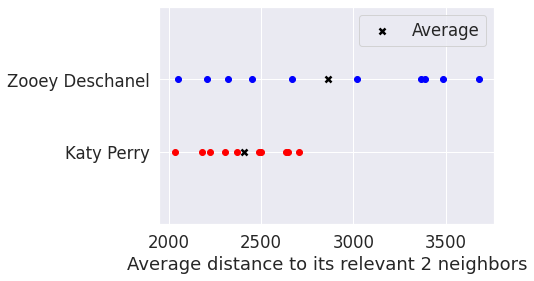

In [ ]:
plt.scatter(avg_dist[0:10],np.zeros((1,10)),c='r')
plt.scatter([np.mean(avg_dist[0:10])],[0],marker='x',c = 'black')
plt.scatter(avg_dist[20:30],np.ones((1,10)),c='b')
plt.scatter([np.mean(avg_dist[20:30])],[1],marker='x',c = 'black',label="Average")
plt.ylabel("")
plt.legend()
plt.xlabel("Average distance to its relevant 2 neighbors")
plt.yticks([0,1],["Katy Perry","Zooey Deschanel"])
plt.ylim([-1,2])

As expected, images of Katy Perry generally lie closer to training images of Katy Perry. However, one images of Zoeey Deschanel has a lower distance to training images of Katy Perry. We don't expect the KNN model to be able to reliably tell the difference between the two.

(-1.0, 2.0)

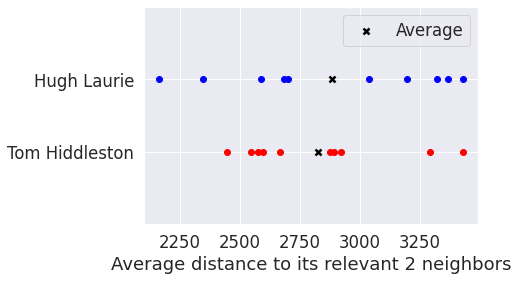

In [ ]:
plt.scatter(avg_dist[10:20],np.zeros((1,10)),c='r')
plt.scatter([np.mean(avg_dist[10:20])],[0],marker='x',c = 'black')
plt.scatter(avg_dist[30:40],np.ones((1,10)),c='b')
plt.scatter([np.mean(avg_dist[30:40])],[1],marker='x',c = 'black',label="Average")
plt.ylabel("")
plt.legend()
plt.xlabel("Average distance to its relevant 2 neighbors")
plt.yticks([0,1],["Tom Hiddleston","Hugh Laurie"])
plt.ylim([-1,2])

The averages behave as expected (though are very close together), but it is clear that differentiating between Hugh Laurie and Tom Hiddleston is not reliable in this case. Increasing the amount of information (number of components) might help.

## Transfer Learning: Classification
To recap, so far we feeded the VGG model with our input images with size (224, 224, 3), and the output was features tensors of (1, 2622) dimension, which we converted into a list: the X_train_tl. We also created the y_train_tl list where we gave labels {0: Katy Perry, 1: Tom Hiddleston}

We are going to feed X_train_tl and y_train_tl into our classifier. Our data are in high dimension, therefore we are going to use a RBF Kernel SVM.

We will repeat the preprocessing step for our test set, which will consist of 10 images of Katy Perry and Zoeey Hiddleston each for class 0 and 10 images for Tom Hiddleston and High Laurie each for class 1, so 40 test images in total.

Moreover, we are going to visualize the test images with t-SNE in order to get an intuition of how our classifier works, and how close the feature embeddings of the persons A and B are to persons C and D.

In [ ]:
# Fit X_train_tl and y_train_tl into the SVM classifier
classifier = svm.SVC()
classifier.fit(X_train_tl,y_train_tl)

SVC(C=1.0, break_ties=False, cache_size=200, class_weight=None, coef0=0.0,
    decision_function_shape='ovr', degree=3, gamma='scale', kernel='rbf',
    max_iter=-1, probability=False, random_state=None, shrinking=True,
    tol=0.001, verbose=False)

Dimensions of test images : 1x224x224x3 pixels
Dimensions of the embeddings of test images: 1x2622 
Dimensions of the face_embeddings_test list:  (40, 1, 2622)
----------------------------------------------------------
Overview of Test faces for Class 0 and Class 1


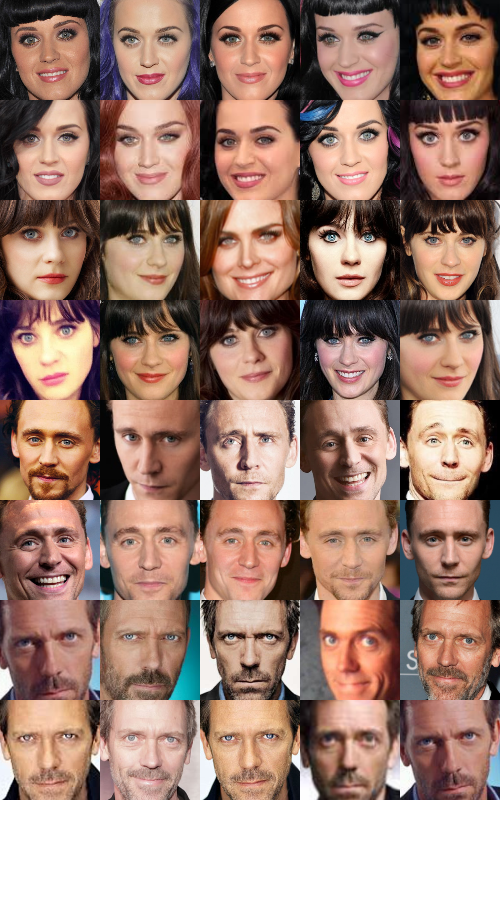

Dimensions of X_test_tl list, containing Embeddings of test images: (40, 2622)


In [ ]:
# Preprocess test set images and create X_test_tl and y_test_tl

# Get face embeddings for Test images

face_embeddings_test = list()
face_cropped_test = list()
faceCascade = cv2.CascadeClassifier(os.path.join(base_path, "haarcascade_frontalface_default.xml"))

for img in test[0]+test[2]+test[1]+test[3]:

  # Extract faces from images
  h,w = img.shape[:2]
  img_ = resize_to_height(img,600)
  img_gray = cv2.cvtColor(img_, cv2.COLOR_BGR2GRAY)

  faces = faceCascade.detectMultiScale(
      img_gray,
      scaleFactor=1.2,
      minNeighbors=5,
      minSize=(30, 30),
      flags=cv2.CASCADE_SCALE_IMAGE
  )

  (x, y, w, h) = faces[0]
  face_cropped_test.append(cv2.resize(img_[y:y+h,x:x+w],(100,100)))

  # Preprocess image
  face = cv2.resize(img_[y:y+h,x:x+w],(224,224))
  crop_img = img_to_array(face)
  crop_img = np.expand_dims(crop_img, axis=0)
  crop_img = preprocess_input(crop_img)

  # Get face embeddings 
  img_encode = vgg_face.predict(crop_img)
  
  face_embeddings_test.append(img_encode)

print("Dimensions of test images : {}x{}x{}x{} pixels".format(crop_img.shape[0],crop_img.shape[1],crop_img.shape[2],crop_img.shape[3]))
print("Dimensions of the embeddings of test images: {}x{} ".format(img_encode.shape[0],img_encode.shape[1]))
print("Dimensions of the face_embeddings_test list: ", np.shape(face_embeddings_test)) 
print("----------------------------------------------------------")

# Visualize Test Faces
print("Overview of Test faces for Class 0 and Class 1")
cv2_imshowmany(face_cropped_test,5,width=100,channels=3)


# Create an X_test list that contains the Embeddings of the test images
# We eliminate the second dimension in order to end up with an array of size (40, 2622)
X_test_tl = np.squeeze(face_embeddings_test, axis=1)

print("Dimensions of X_test_tl list, containing Embeddings of test images:", np.shape(X_test_tl))

# Create a y_test array that contains labels: 
# - 0 for Katy Perry + Zoeey Hiddleston, 
# - 1 for Tom Hiddleston + Hugh Laurie

y_test_tl = list()
for i in range(40):
  if i < 20:
    y_test_tl.append(0)
  else:
    y_test_tl.append(1)

y_test_tl = np.array(y_test_tl)

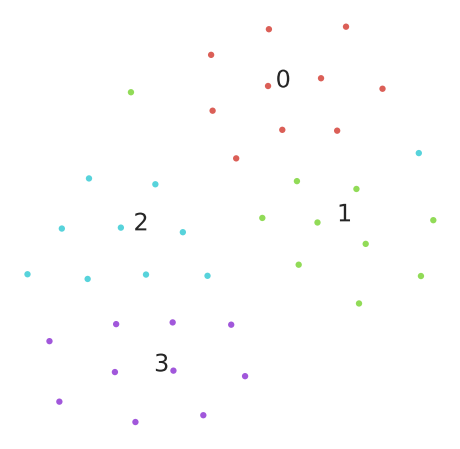

In [ ]:
# Visualize Test set with t-SNE

# Create a y_test_persons array that contains labels: 
# - 0 for Katy Perry
# - 1 for Zoeey Hiddleston
# - 2 for Tom Hiddleston 
# - 3 for Hugh Laurie
y_test_persons = list()
for i in range(40):
  if i < 10:
    y_test_persons.append(0)
  elif i >= 10 and i < 20:
    y_test_persons.append(1)
  elif i >= 20 and i < 30:
    y_test_persons.append(2)
  else:
    y_test_persons.append(3)

y_test_persons = np.array(y_test_persons)

test_faces_proj = TSNE(random_state=RS).fit_transform(X_test_tl)

# Here is the result
scatter(test_faces_proj, y_test_persons, nlabels=4)
plt.savefig('./tsne-generated-test.png', dpi=120)

As mentioned before, t-SNE is a nonlinear dimensionality reduction technique well-suited for embedding high-dimensional data for visualization in a low-dimensional space of two dimensions. 

In this visualization, similar face-embeddings are modeled as nearby points and dissimilar face-embeddings are modeled by distant points.

From the resulting graph, we see clearly the 4 clusters representing the 4 different persons. We also notice that 0: Katy Perry is more similar to 1: Zoeey Hiddleston, while 2: Tom Hiddleston is similar to 3: Hugh Laurie. 

There is also a clear separation between the female actors and the male actors, which is an encouraging indication regarding the performance of our Classifier, using the obtained face-embeddings.

There are also some outliers in the data. For example, there is a photo from cluster {1: Zoeey Hiddleston}, which is located far away from the rest of the pictures of the same person. This is happening because, looking at the detected faces of the test set, there was a picture with Zoeey Hiddleston and a second actress and our face detector picked the latter one. However, because this actress is female, is located closer to Katy Perry and Zoeey Hiddleston, rather than to the two male actors, in the t-SNE 2-dimensional space. 


Now we will use our SVM classifier to make predictions for the Test set and evaluate the mean accuracy.

In [ ]:
# Make predictions for X_test set
y_pred = classifier.predict(X_test_tl)
print("Predictions: ", y_pred)
print("True labels: ", y_test_tl)

# Evaluate accuracy
accuracy = accuracy_score(y_pred, y_test_tl)

# Print results
print("Mean Accuracy of Classifier: ", accuracy*100,"%")
discussion_results["TL_classification"] = accuracy

Predictions:  [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1]
True labels:  [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1]
Mean Accuracy of Classifier:  100.0 %


Our SVM classifier makes correct predictions for all our test images and we obtain an accuracy of 100% !

## Transfer Learning: Identification
For the identification part, we are going to use k-Nearest-Neighbor technique on our training data space of Face embeddings of 2622 dimensions, obtained by the VGGFace Model. The KNN Algorithm in essence stores the training data, then calculates a distance metric with each test instance, and classify it according to the majority class of the K nearest points.

We are setting number of neighbors = 5 and we use L2 distance metric: Euclidean Distance.

We will use X_train and y_train to fit the KNN model. Then we will make predictions for X_test and evaluate the results.

In [ ]:
# Fit K-Nearest-Neighbor to our Training data
knn = KNeighborsClassifier(n_neighbors = 5, metric = 'minkowski', p = 2)
knn.fit(X_train_tl, y_train_tl)

# Make predictions for X_test set
y_pred = knn.predict(X_test_tl)
print("Predictions: ", y_pred)
print("True labels: ", y_test_tl)

# Evaluate accuracy
accuracy = accuracy_score(y_test_tl, y_pred, normalize=True)

# Print results
print("Mean Accuracy of Identifier: ", accuracy*100,"%")
discussion_results["TL_identification"] = accuracy

Predictions:  [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1]
True labels:  [0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1]
Mean Accuracy of Identifier:  100.0 %


Again, we obtain accuracy 100% !

To complete the identification part, we will showcase for each image in Test set, the 2 Nearest Neighbors from the Train set, meaning the 2 images with the smallest distance.

To achieve that, we use the NearestNeighbors algorithm from Scikit-Learn library. We will fit the NearestNeighbors object to the Traning Images, using Ball Tree algorithm. Ball Tree an efficient method for large datasets, as it doesn't explicitely calculate the distance between all datapoint. It is also suitable for high-dimensional data like ours.

Aftre fitting NearestNeighborts to Train set, we are going to find for each Test Image the 2 Nearest Neighbors and calculate the distances between them. 

Finally, we are going to visualize the results: the classification result for the test images using KNN Classifier and the 2 Nearest Neighbors with their distance.


Overview of the Indices of the 2 Nearest Neighbors from Training Set for the first 5 images in Test set
[[ 4  2]
 [ 5  7]
 [ 7 16]
 [ 2  5]
 [ 4  2]]
                                                                            
Overview of the Distances between the 2 Nearest Neighbors from Training set and the first 5 images in Test set
[[ 71.64138871  73.06057049]
 [ 73.18694418  81.0680704 ]
 [ 81.90255912  82.37563679]
 [ 76.53815496  80.49147321]
 [ 94.74687387 100.60428878]]
                                                                            
 -- Test Image --  -- Neighbor 1 --  -- Neighbor 2 --


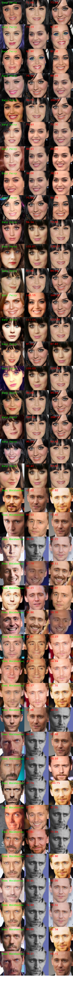

In [ ]:
nbrs = NearestNeighbors(n_neighbors=2, algorithm='ball_tree').fit(X_train_tl)
distances, indices = nbrs.kneighbors(X_test_tl)

print("Overview of the Indices of the 2 Nearest Neighbors from Training Set for the first 5 images in Test set")
print(indices[:5, :])
print("                                                                            ")
print("Overview of the Distances between the 2 Nearest Neighbors from Training set and the first 5 images in Test set")
print(distances[:5, :])

# Merge face_cropped_A and face_cropped_B lists into face_cropped_train
face_cropped_train = np.concatenate((face_cropped_A, face_cropped_B), axis=0)

# Make list that contains the Test faces with their 2 Nearest Neighbors
neighbors_res = []

# Create a list of the average distance of the 2 Nearest Neighbors for the Test images
avg_dist_tl = []

# For loop that iterated over the 40 Test images, performs KNN classification
# and finds the indices and distances of the 2 Nearest Neighboring faces from the Train Set
for i in range(40):

  # Get face embeddings 
  img_encode = face_embeddings_test[i]

  # Apply KNN identifier
  res = knn.predict(img_encode)

  if res == 0:
    p = "Katy Perry"
  else:
    p = "Tom Hiddleston"
  
  imgt = face_cropped_test[i]
  imgt = resize_to_width(imgt,150)
  imgt = cv2.putText(imgt,p,(10,20),cv2.FONT_HERSHEY_COMPLEX_SMALL,0.7,(0,255,0),1)

  neighbors_res.append(imgt)

  # Find Distances and Indices of 2 Nearest Neighbors
  distances, indices = nbrs.kneighbors(img_encode)

  avg_dist_tl.append(np.mean(distances))

  p1, p2 = indices[0]
  d1, d2 = distances[0]

  img1 = face_cropped_train[p1]
  img1 = resize_to_width(img1, 150)
  img1 = cv2.putText(img1,format(d1,'.2f'),(10,20),cv2.FONT_HERSHEY_COMPLEX_SMALL,0.8,(0,0,255),1)
  neighbors_res.append(img1)

  img2 = face_cropped_train[p2]
  img2 = resize_to_width(img2, 150)
  img2 = cv2.putText(img2,format(d2,'.2f'),(10,20),cv2.FONT_HERSHEY_COMPLEX_SMALL,0.8,(0,0,255),1)
  neighbors_res.append(img2)

print("                                                                            ")
print(" -- Test Image --  -- Neighbor 1 --  -- Neighbor 2 --")
cv2_imshowmany(neighbors_res, ncols=3, width=150, channels=3)

Like before, we visualize the average distance of each Test Image with each 2 Nearest Neighbors from the Train Set. We expect that the distances are smaller for persons A and C compared to B and D.

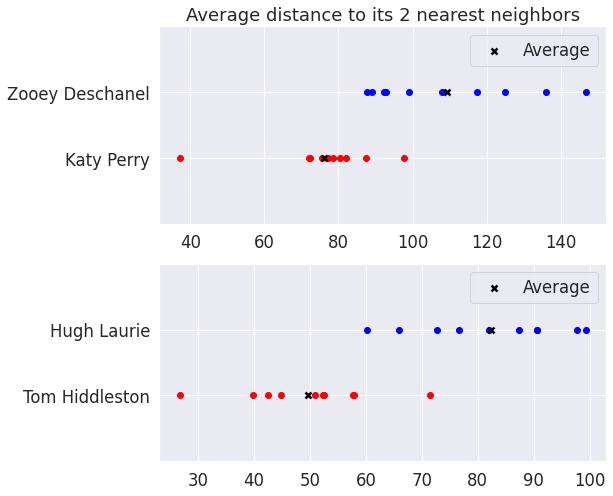

In [ ]:
plt.figure(figsize=(8,8))
plt.subplot(2,1,1)
plt.scatter(avg_dist_tl[0:10],np.zeros((1,10)),c='r')
plt.scatter([np.mean(avg_dist_tl[0:10])],[0],marker='x',c = 'black')
plt.scatter(avg_dist_tl[10:20],np.ones((1,10)),c='b')
plt.scatter([np.mean(avg_dist_tl[10:20])],[1],marker='x',c = 'black',label="Average")
plt.ylabel("")
plt.legend()
plt.yticks([0,1],["Katy Perry","Zooey Deschanel"])
plt.title("Average distance to its 2 nearest neighbors")
plt.ylim([-1,2])

plt.subplot(2,1,2)
plt.scatter(avg_dist_tl[20:30],np.zeros((1,10)),c='r')
plt.scatter([np.mean(avg_dist_tl[20:30])],[0],marker='x',c = 'black')
plt.scatter(avg_dist_tl[30:40],np.ones((1,10)),c='b')
plt.scatter([np.mean(avg_dist_tl[30:40])],[1],marker='x',c = 'black',label="Average")
plt.ylabel("")
plt.legend()
plt.yticks([0,1],["Tom Hiddleston","Hugh Laurie"])
plt.ylim([-1,2])

plt.show()

# Section F: Discussion

We started of by building a training and test dataset. Initially, this dataset was not very good, which we discovered when applying face recognition to it. Common problems we encountered were:
1. **Low resolution:** most feature representations rely on the fact that faces are more or less MxN pixels, and large deviations from this size may worsen detection. For example, a HOG descriptor implicitly makes this assumption when describing features like eyes: two eyes of completely different sizes will have very different HOG vectors (given some parameters). Performing detection on an image pyramid instead of a static image may help to overcome this problem, but still requires you to specify maximum and minimum sizes. We generally used very high-res images (4000px on each side), extracted the face (whose size then ranged from 300 to 3000px). This gave us enough information to work with in all cases.
2. **Inconsistencies** with regard to stance, hairstyles, orientation, ... Often times, you don't realize how sensitive models are to all kinds of inconsistencies that our human 'face detection' doesn't struggle with. We encountered some cases where a person was looking slightly to the left, of tilted his or her head. These differences can easily fool classifiers. We chose to make a very uniform dataset (to increase preciseness of the feature descriptors), but as a result we have no evidence as to how it performs on data that doesn't really conform to our data. Given more time, this would have been interesting to look at.

Next, some preprocessing was needed. Common steps include (not in any particular order):

*   **Resizing**: for the same reason as above, and because all three feature descriptions in this assignment make assumptions about the size of its inputs (mostly vectors).
*   **Convert to grayscale**: the overall goal of feature descriptors is to capture *enough* data, but capture it as *concisely* as possible. This tradeoff is the driving force between most design choices we had to make. Intuitively, colors do not seem to capture much information when detecting faces, so it makes sense to do all detection in grayscale (which reduces the amount of information by 2/3). However, when doing identification this may lead to bad result. Imagine a case where two individuals look very similar, but have a different hair color. No human would make any mistakes identifying them, but our feature descriptors effectively ignore this information.
*   **Reshape**: most algorithms work on vectors, so a simple reshape operation is enough to make an image into a vector.

We looked at three feature descriptors:
*   **HOG descriptor**: the History of oriented gradients method captures information about edges (we saw that edges are highly informative) concisely by binning them according to their orientation. This model has many parameters, and it is often not immediately clear which values work for our application. This is the reason why we chose to tune the parameters automatically in the section "Impress your TA's".
*   **Principal Component Analysis**: the goal of PCA is to throw away as much irrelevant information. It formalizes relevant and irrelevant information through the use of principal components: dimension that carry the most information. This way, we no longer need to make these decisions based on intuition.
*   **Transfer learning**: in this section we capitalized on the power of Deep Learning, using a pretrained ConvNet on millions of images from the internet, to extract relevant face embeddings. From the given model architecture, we removed the last softmax layer, thus the adapted model would output not a class label, but a 2622-dimensional feature vector. In terms of performance, this feature representation is the most powerful one, resulting from the Deep Learning architecture and training on a very large dataset.

As a measure of how informative each feature description is, we take a look at the shape of its input.

In [ ]:
print("Feature description    |     HOG        |  HOG(improved)  |       PCA       |       TL      |")
print("Input shape            |   {}     |  {}     |    {}    |   {}   |".format(discussion_shapes["HOG"],discussion_shapes["HOGi"],discussion_shapes["PCA"],discussion_shapes["TL"]))


Feature description    |     HOG        |  HOG(improved)  |       PCA       |       TL      |
Input shape            |   (900, 1)     |  (24624, 1)     |    (1, 5625)    |   (1, 2622)   |


It is clear how the input to HOG was initially fairly small, but the results were not eactly good. After improvement, the HOG vector became very large. It's clear that parameter tuning using HOG easily gives large vectors (the vector size is linearly or quadratically correlated to the parameter values). 

We also look at the achieved accuracies.

In [ ]:
print("Feature description                  |     HOG      |     HOG(improved)  |     PCA    |    TL   |")
print("Accuracy (identification)            |     {}     |          {}         |     {}   |   {}   |".format(discussion_results["HOG_identification"],discussion_results["HOGi_identification"],discussion_results["PCA_identification"],discussion_results["TL_identification"]))
print("Accuracy (classification)            |     {}     |          {}         |     {}   |   {}   |".format(discussion_results["HOG_classification"],discussion_results["HOGi_classification"],discussion_results["PCA_classification"],discussion_results["TL_classification"]))

Feature description                  |     HOG      |     HOG(improved)  |     PCA    |    TL   |
Accuracy (identification)            |     0.95     |          1         |     0.95   |   1.0   |
Accuracy (classification)            |     0.75     |          1         |     0.95   |   1.0   |


After improving HOG, all three models achieve good results on our dataset. The results on datasets that are larger and more varied are not so clear.

